Code for **"Blind restoration of a JPEG-compressed image"** and **"Blind image denoising"** figures. Select `fname` below to switch between the two.

- To see overfitting set `num_iter` to a large value.

In [1]:
"""
*Uncomment if running on colab* 
Set Runtime -> Change runtime type -> Under Hardware Accelerator select GPU in Google Colab 
"""
# !git clone https://github.com/DmitryUlyanov/deep-image-prior
# !mv deep-image-prior/* ./

'\n*Uncomment if running on colab* \nSet Runtime -> Change runtime type -> Under Hardware Accelerator select GPU in Google Colab \n'

# Import libs

In [2]:
from __future__ import print_function
import matplotlib.pyplot as plt
%matplotlib inline

import os
#os.environ['CUDA_VISIBLE_DEVICES'] = '3'

import numpy as np
from models import *

import torch
import torch.optim

from skimage.measure import compare_psnr
from utils.denoising_utils import *

import time

start_time = time.perf_counter()

# torch.backends.cudnn.enabled = True
# torch.backends.cudnn.benchmark =True
# dtype = torch.cuda.FloatTensor
dtype = torch.Tensor

imsize =-1
PLOT = True
sigma = 25
sigma_ = sigma/255.

In [3]:
# deJPEG 
# fname = 'data/denoising/snail.jpg'

## denoising
fname = 'data/denoising/F16_GT.png'

# Load image

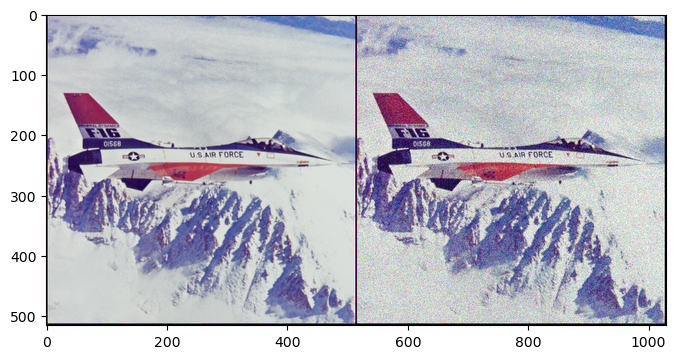

In [4]:
if fname == 'data/denoising/snail.jpg':
    img_noisy_pil = crop_image(get_image(fname, imsize)[0], d=32)
    img_noisy_np = pil_to_np(img_noisy_pil)
    
    # As we don't have ground truth
    img_pil = img_noisy_pil
    img_np = img_noisy_np
    
    if PLOT:
        plot_image_grid([img_np], 4, 5);
        
elif fname == 'data/denoising/F16_GT.png':
    # Add synthetic noise
    img_pil = crop_image(get_image(fname, imsize)[0], d=32)
    img_np = pil_to_np(img_pil)
    
    img_noisy_pil, img_noisy_np = get_noisy_image(img_np, sigma_)
    
    if PLOT:
        plot_image_grid([img_np, img_noisy_np], 4, 6);
else:
    assert False

# Setup

In [5]:
INPUT = 'noise' # 'meshgrid'
pad = 'reflection'
OPT_OVER = 'net' # 'net,input'

reg_noise_std = 1./30. # set to 1./20. for sigma=50
LR = 0.01

OPTIMIZER='adam' # 'LBFGS'
show_every = 5
exp_weight=0.99

if fname == 'data/denoising/snail.jpg':
    num_iter = 2400
    input_depth = 3
    figsize = 5 
    
    net = skip(
                input_depth, 3, 
                num_channels_down = [8, 16, 32, 64, 128], 
                num_channels_up   = [8, 16, 32, 64, 128],
                num_channels_skip = [0, 0, 0, 4, 4], 
                upsample_mode='bilinear',
                need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU')

    net = net.type(dtype)

elif fname == 'data/denoising/F16_GT.png':
    num_iter = 3000
    input_depth = 32 
    figsize = 4 
    
    
    net = get_net(input_depth, 'skip', pad,
                  skip_n33d=128, 
                  skip_n33u=128, 
                  skip_n11=4, 
                  num_scales=5,
                  upsample_mode='bilinear').type(dtype)

else:
    assert False
    
net_input = get_noise(input_depth, INPUT, (img_pil.size[1], img_pil.size[0])).type(dtype).detach()

# Compute number of parameters
s  = sum([np.prod(list(p.size())) for p in net.parameters()]); 
print ('Number of params: %d' % s)

# Loss
mse = torch.nn.MSELoss().type(dtype)

img_noisy_torch = np_to_torch(img_noisy_np).type(dtype)

Number of params: 2217831


# Optimize

Starting optimization with ADAM


/home/nk1495/.conda/envs/deep-image-prior/lib/python3.7/site-packages/torch/nn/modules/upsampling.py:122: UserWarning: nn.Upsampling is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.Upsampling is deprecated. Use nn.functional.interpolate instead.")
/home/nk1495/.conda/envs/deep-image-prior/lib/python3.7/site-packages/torch/nn/functional.py:1961: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
/home/nk1495/.conda/envs/deep-image-prior/lib/python3.7/site-packages/ipykernel_launcher.py:30: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
/home/nk1495/.conda/envs/deep-image-prior/lib/python3.7/site-packages/

Iteration 00000    Loss 0.084728   PSNR_noisy: 10.719738   PSRN_gt: 11.185659 PSNR_gt_sm: 11.185659 
Elapsed time: 26.2753 seconds


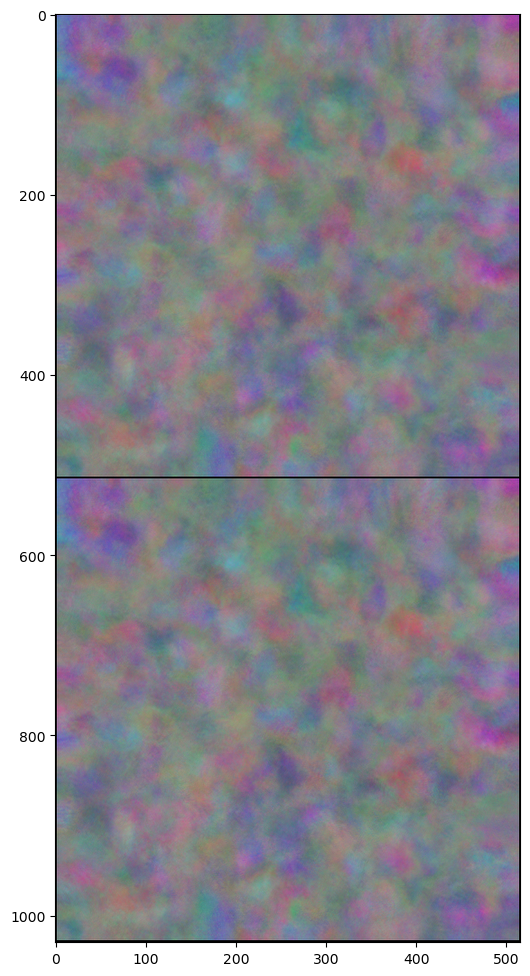

Iteration 00001    Loss 0.070076   PSNR_noisy: 11.544281   PSRN_gt: 12.121457 PSNR_gt_sm: 11.203495 
Elapsed time: 52.4537 seconds
Iteration 00002    Loss 0.050120   PSNR_noisy: 12.999923   PSRN_gt: 13.838896 PSNR_gt_sm: 11.236237 
Elapsed time: 77.9367 seconds
Iteration 00003    Loss 0.065682   PSNR_noisy: 11.825517   PSRN_gt: 12.451404 PSNR_gt_sm: 11.269404 
Elapsed time: 103.1390 seconds
Iteration 00004    Loss 0.040343   PSNR_noisy: 13.942276   PSRN_gt: 15.031393 PSNR_gt_sm: 11.323541 
Elapsed time: 127.4960 seconds
Iteration 00005    Loss 0.036816   PSNR_noisy: 14.339616   PSRN_gt: 15.554272 PSNR_gt_sm: 11.387317 
Elapsed time: 152.3446 seconds


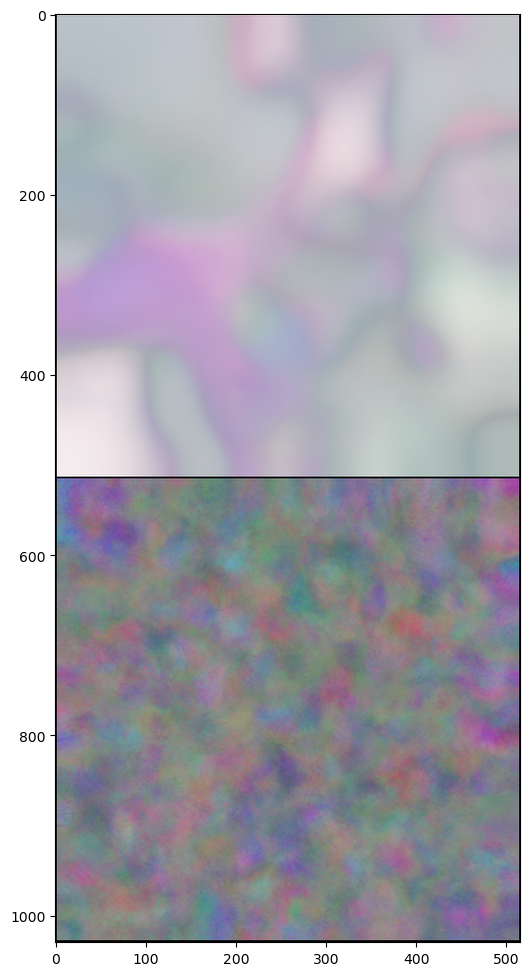

Iteration 00006    Loss 0.037824   PSNR_noisy: 14.222282   PSRN_gt: 15.405463 PSNR_gt_sm: 11.453701 
Elapsed time: 178.4516 seconds
Iteration 00007    Loss 0.036211   PSNR_noisy: 14.411560   PSRN_gt: 15.658728 PSNR_gt_sm: 11.523790 
Elapsed time: 203.8914 seconds
Iteration 00008    Loss 0.034141   PSNR_noisy: 14.667225   PSRN_gt: 16.003734 PSNR_gt_sm: 11.592322 
Elapsed time: 229.4029 seconds
Iteration 00009    Loss 0.033206   PSNR_noisy: 14.787771   PSRN_gt: 16.173192 PSNR_gt_sm: 11.664500 
Elapsed time: 256.3206 seconds
Iteration 00010    Loss 0.031467   PSNR_noisy: 15.021451   PSRN_gt: 16.489054 PSNR_gt_sm: 11.732440 
Elapsed time: 284.6220 seconds


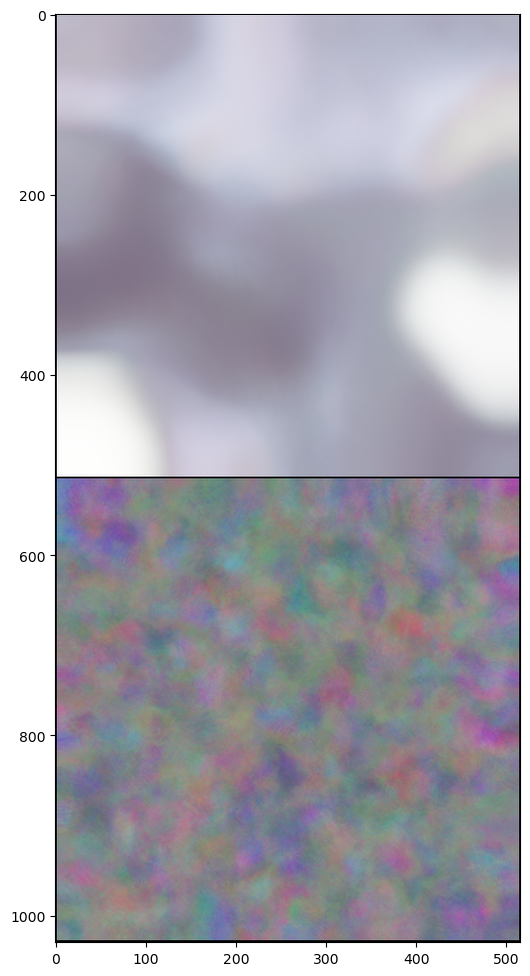

Iteration 00011    Loss 0.032271   PSNR_noisy: 14.911844   PSRN_gt: 16.332830 PSNR_gt_sm: 11.797014 
Elapsed time: 313.2779 seconds
Iteration 00012    Loss 0.031112   PSNR_noisy: 15.070757   PSRN_gt: 16.557725 PSNR_gt_sm: 11.862545 
Elapsed time: 340.5940 seconds
Iteration 00013    Loss 0.029803   PSNR_noisy: 15.257347   PSRN_gt: 16.821526 PSNR_gt_sm: 11.927445 
Elapsed time: 366.6913 seconds
Iteration 00014    Loss 0.030136   PSNR_noisy: 15.209131   PSRN_gt: 16.753024 PSNR_gt_sm: 11.995056 
Elapsed time: 392.0175 seconds
Iteration 00015    Loss 0.029349   PSNR_noisy: 15.324000   PSRN_gt: 16.917923 PSNR_gt_sm: 12.061783 
Elapsed time: 417.5035 seconds


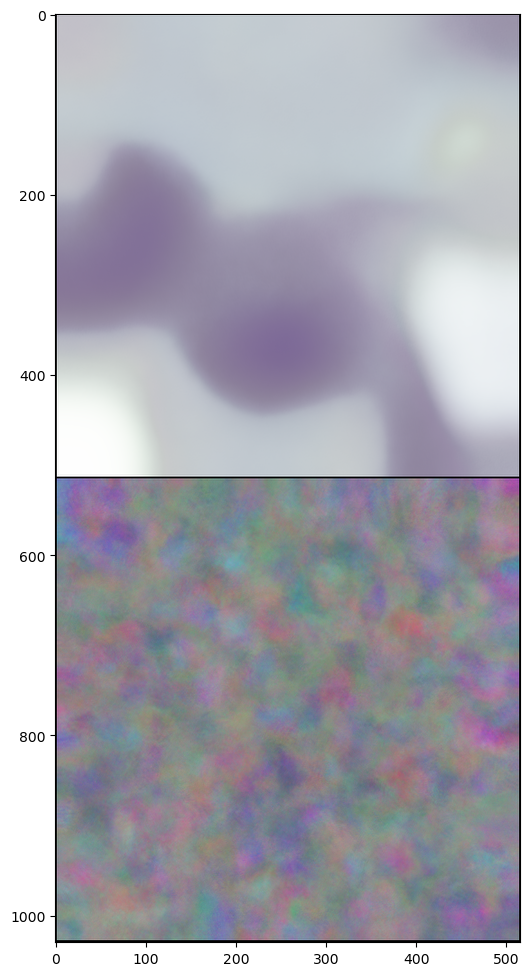

Iteration 00016    Loss 0.029308   PSNR_noisy: 15.330082   PSRN_gt: 16.923833 PSNR_gt_sm: 12.125966 
Elapsed time: 443.4621 seconds
Iteration 00017    Loss 0.029622   PSNR_noisy: 15.283856   PSRN_gt: 16.850984 PSNR_gt_sm: 12.188224 
Elapsed time: 467.9056 seconds
Iteration 00018    Loss 0.028853   PSNR_noisy: 15.398060   PSRN_gt: 17.019134 PSNR_gt_sm: 12.251221 
Elapsed time: 493.3013 seconds
Iteration 00019    Loss 0.028318   PSNR_noisy: 15.479426   PSRN_gt: 17.136609 PSNR_gt_sm: 12.311781 
Elapsed time: 518.8822 seconds
Iteration 00020    Loss 0.028381   PSNR_noisy: 15.469739   PSRN_gt: 17.120850 PSNR_gt_sm: 12.372506 
Elapsed time: 544.2658 seconds


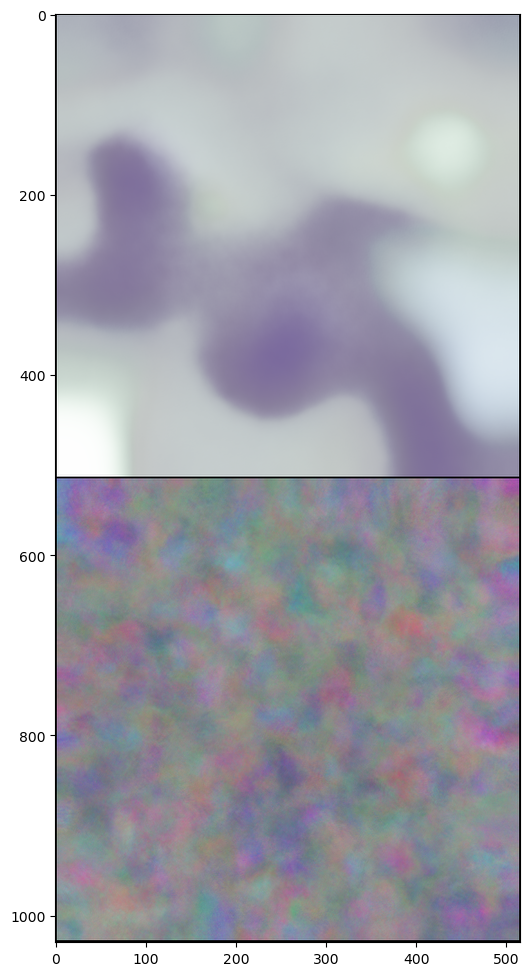

Iteration 00021    Loss 0.028329   PSNR_noisy: 15.477625   PSRN_gt: 17.128253 PSNR_gt_sm: 12.430865 
Elapsed time: 570.1924 seconds
Iteration 00022    Loss 0.027964   PSNR_noisy: 15.533930   PSRN_gt: 17.213682 PSNR_gt_sm: 12.491071 
Elapsed time: 595.5003 seconds
Iteration 00023    Loss 0.027034   PSNR_noisy: 15.680895   PSRN_gt: 17.438290 PSNR_gt_sm: 12.554224 
Elapsed time: 620.7522 seconds
Iteration 00024    Loss 0.027470   PSNR_noisy: 15.611467   PSRN_gt: 17.333228 PSNR_gt_sm: 12.614354 
Elapsed time: 646.2232 seconds
Iteration 00025    Loss 0.027128   PSNR_noisy: 15.665883   PSRN_gt: 17.412257 PSNR_gt_sm: 12.675937 
Elapsed time: 671.5334 seconds


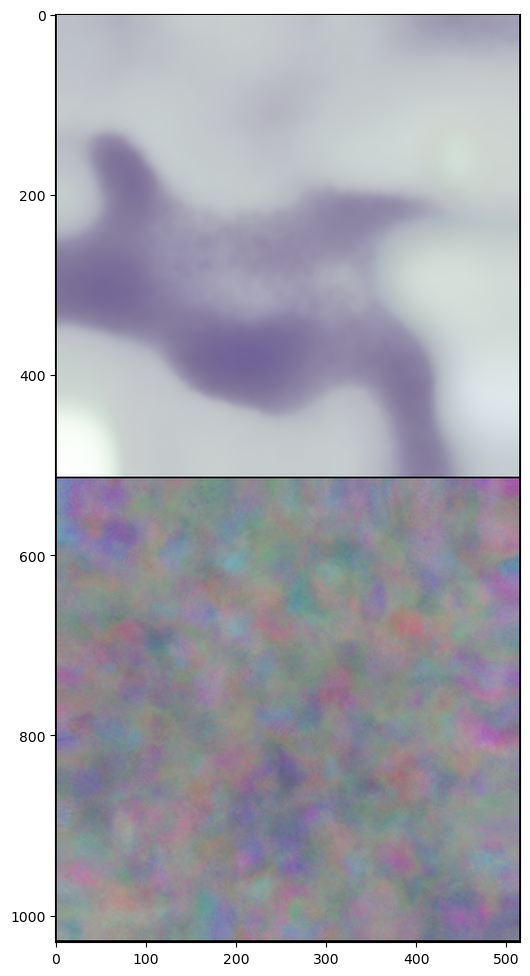

Iteration 00026    Loss 0.026802   PSNR_noisy: 15.718390   PSRN_gt: 17.492521 PSNR_gt_sm: 12.737522 
Elapsed time: 697.7708 seconds
Iteration 00027    Loss 0.026703   PSNR_noisy: 15.734371   PSRN_gt: 17.515815 PSNR_gt_sm: 12.798827 
Elapsed time: 723.1123 seconds
Iteration 00028    Loss 0.026315   PSNR_noisy: 15.797942   PSRN_gt: 17.612583 PSNR_gt_sm: 12.858793 
Elapsed time: 748.4343 seconds
Iteration 00029    Loss 0.026720   PSNR_noisy: 15.731715   PSRN_gt: 17.505492 PSNR_gt_sm: 12.916032 
Elapsed time: 773.8490 seconds
Iteration 00030    Loss 0.025919   PSNR_noisy: 15.863768   PSRN_gt: 17.710378 PSNR_gt_sm: 12.972859 
Elapsed time: 799.2650 seconds


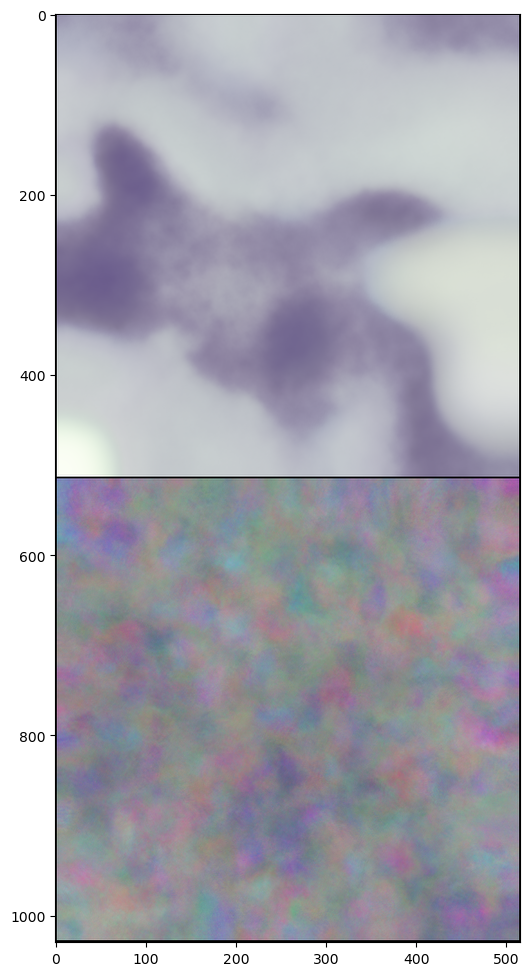

Iteration 00031    Loss 0.025769   PSNR_noisy: 15.888946   PSRN_gt: 17.747292 PSNR_gt_sm: 13.031374 
Elapsed time: 825.4683 seconds
Iteration 00032    Loss 0.025269   PSNR_noisy: 15.974132   PSRN_gt: 17.884244 PSNR_gt_sm: 13.091253 
Elapsed time: 850.7441 seconds
Iteration 00033    Loss 0.025506   PSNR_noisy: 15.933561   PSRN_gt: 17.818258 PSNR_gt_sm: 13.149625 
Elapsed time: 876.2285 seconds
Iteration 00034    Loss 0.024990   PSNR_noisy: 16.022349   PSRN_gt: 17.956750 PSNR_gt_sm: 13.208962 
Elapsed time: 901.6306 seconds
Iteration 00035    Loss 0.025046   PSNR_noisy: 16.012670   PSRN_gt: 17.942758 PSNR_gt_sm: 13.267488 
Elapsed time: 927.0930 seconds


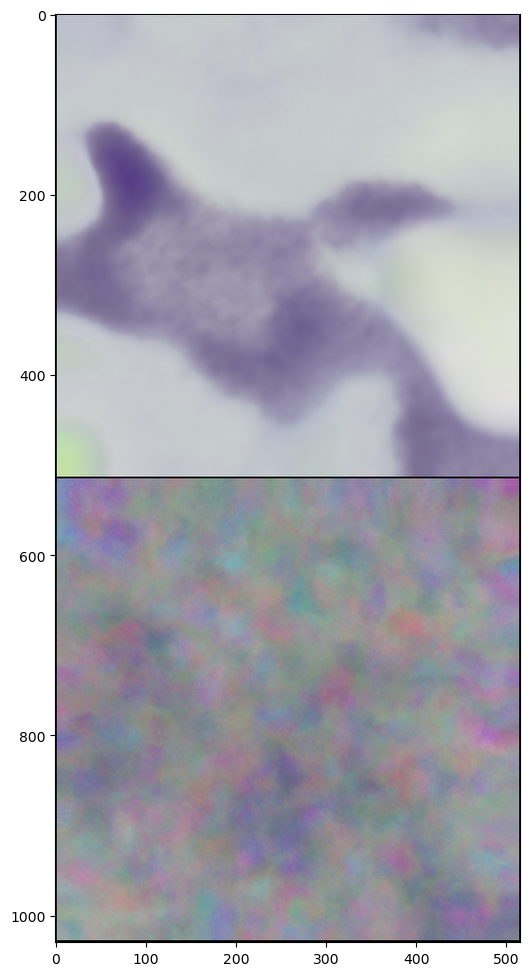

Iteration 00036    Loss 0.025026   PSNR_noisy: 16.016010   PSRN_gt: 17.946629 PSNR_gt_sm: 13.326254 
Elapsed time: 953.1452 seconds
Iteration 00037    Loss 0.025430   PSNR_noisy: 15.946611   PSRN_gt: 17.836512 PSNR_gt_sm: 13.382348 
Elapsed time: 978.4426 seconds
Iteration 00038    Loss 0.024792   PSNR_noisy: 16.056798   PSRN_gt: 18.013142 PSNR_gt_sm: 13.437954 
Elapsed time: 1003.6487 seconds
Iteration 00039    Loss 0.024157   PSNR_noisy: 16.169599   PSRN_gt: 18.191293 PSNR_gt_sm: 13.493503 
Elapsed time: 1028.9438 seconds
Iteration 00040    Loss 0.024335   PSNR_noisy: 16.137775   PSRN_gt: 18.140382 PSNR_gt_sm: 13.550054 
Elapsed time: 1054.2073 seconds


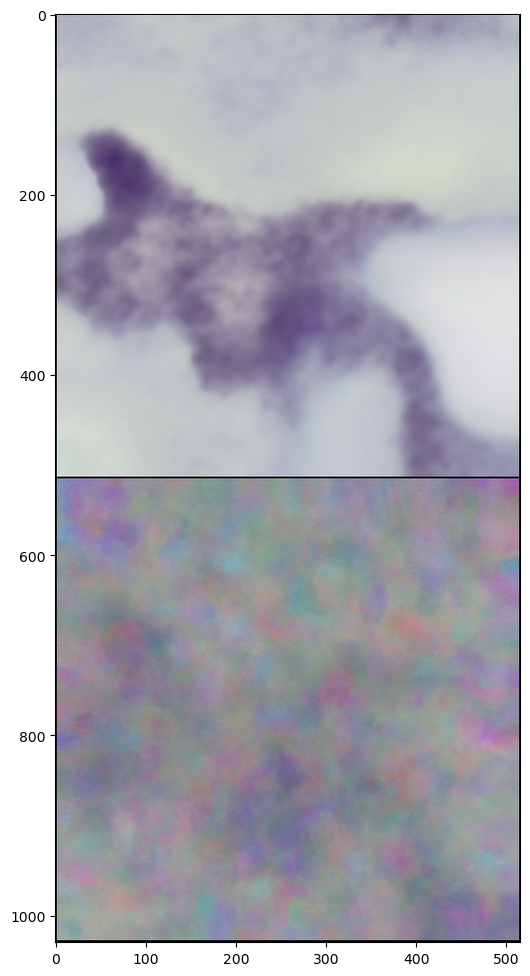

Iteration 00041    Loss 0.023811   PSNR_noisy: 16.232273   PSRN_gt: 18.296110 PSNR_gt_sm: 13.608195 
Elapsed time: 1079.9690 seconds
Iteration 00042    Loss 0.023108   PSNR_noisy: 16.362431   PSRN_gt: 18.509282 PSNR_gt_sm: 13.667309 
Elapsed time: 1105.2760 seconds
Iteration 00043    Loss 0.023788   PSNR_noisy: 16.236358   PSRN_gt: 18.301877 PSNR_gt_sm: 13.725643 
Elapsed time: 1130.9266 seconds
Iteration 00044    Loss 0.022987   PSNR_noisy: 16.385223   PSRN_gt: 18.545545 PSNR_gt_sm: 13.785915 
Elapsed time: 1156.4518 seconds
Iteration 00045    Loss 0.023341   PSNR_noisy: 16.318805   PSRN_gt: 18.436839 PSNR_gt_sm: 13.844582 
Elapsed time: 1181.7556 seconds


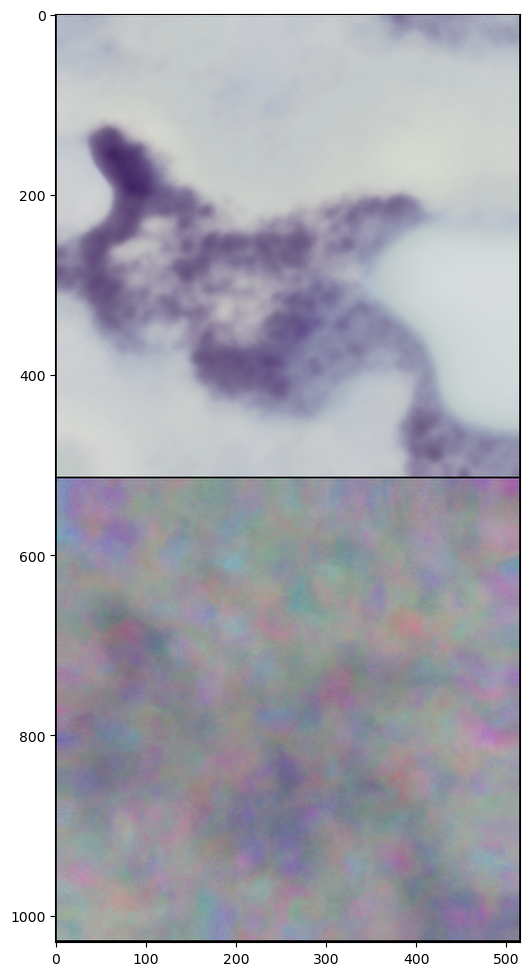

Iteration 00046    Loss 0.023129   PSNR_noisy: 16.358370   PSRN_gt: 18.502661 PSNR_gt_sm: 13.902382 
Elapsed time: 1207.8786 seconds
Iteration 00047    Loss 0.022854   PSNR_noisy: 16.410395   PSRN_gt: 18.593307 PSNR_gt_sm: 13.960397 
Elapsed time: 1233.2170 seconds
Iteration 00048    Loss 0.022747   PSNR_noisy: 16.430741   PSRN_gt: 18.629877 PSNR_gt_sm: 14.017965 
Elapsed time: 1258.6093 seconds
Iteration 00049    Loss 0.022250   PSNR_noisy: 16.526726   PSRN_gt: 18.783230 PSNR_gt_sm: 14.075539 
Elapsed time: 1283.9329 seconds
Iteration 00050    Loss 0.022111   PSNR_noisy: 16.553838   PSRN_gt: 18.831809 PSNR_gt_sm: 14.133756 
Elapsed time: 1309.3092 seconds


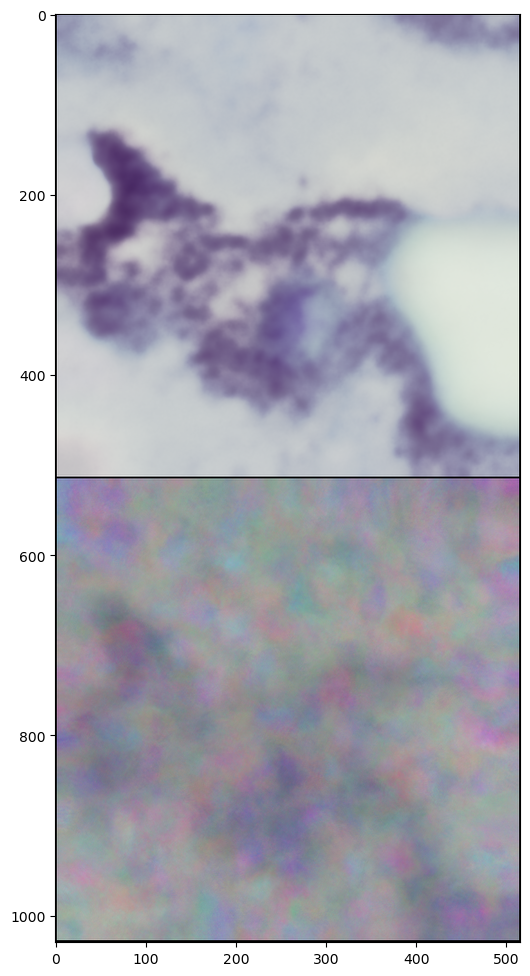

Iteration 00051    Loss 0.021819   PSNR_noisy: 16.611704   PSRN_gt: 18.931248 PSNR_gt_sm: 14.191191 
Elapsed time: 1335.3443 seconds
Iteration 00052    Loss 0.022223   PSNR_noisy: 16.532040   PSRN_gt: 18.792915 PSNR_gt_sm: 14.249035 
Elapsed time: 1360.6515 seconds
Iteration 00053    Loss 0.021854   PSNR_noisy: 16.604662   PSRN_gt: 18.918837 PSNR_gt_sm: 14.308321 
Elapsed time: 1386.1363 seconds
Iteration 00054    Loss 0.021725   PSNR_noisy: 16.630313   PSRN_gt: 18.959349 PSNR_gt_sm: 14.365112 
Elapsed time: 1411.6557 seconds
Iteration 00055    Loss 0.021161   PSNR_noisy: 16.744545   PSRN_gt: 19.159144 PSNR_gt_sm: 14.423069 
Elapsed time: 1437.0337 seconds


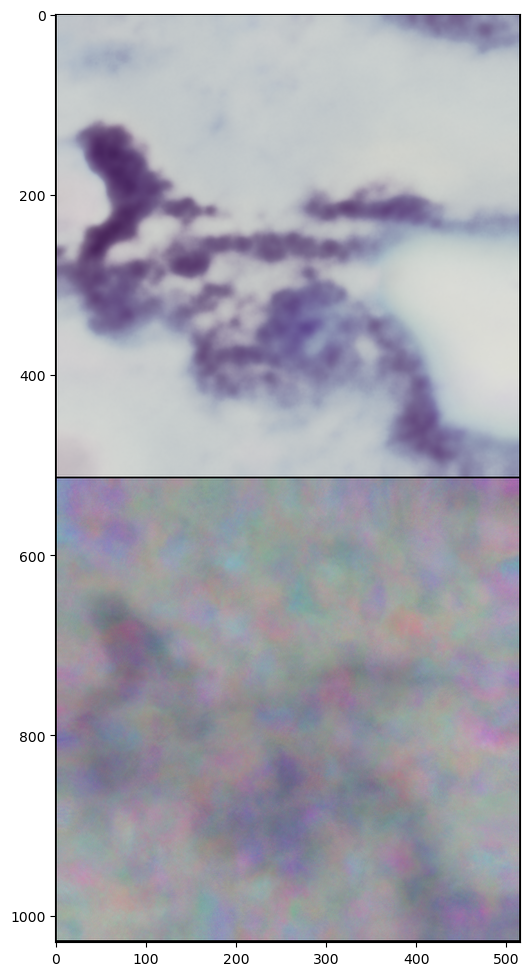

Iteration 00056    Loss 0.021726   PSNR_noisy: 16.630291   PSRN_gt: 18.956860 PSNR_gt_sm: 14.481275 
Elapsed time: 1463.0924 seconds
Iteration 00057    Loss 0.021562   PSNR_noisy: 16.663060   PSRN_gt: 19.015526 PSNR_gt_sm: 14.538508 
Elapsed time: 1488.8029 seconds
Iteration 00058    Loss 0.020599   PSNR_noisy: 16.861604   PSRN_gt: 19.365142 PSNR_gt_sm: 14.598086 
Elapsed time: 1513.1031 seconds
Iteration 00059    Loss 0.020723   PSNR_noisy: 16.835523   PSRN_gt: 19.318001 PSNR_gt_sm: 14.655126 
Elapsed time: 1538.4824 seconds
Iteration 00060    Loss 0.021432   PSNR_noisy: 16.689332   PSRN_gt: 19.067894 PSNR_gt_sm: 14.710497 
Elapsed time: 1563.9613 seconds


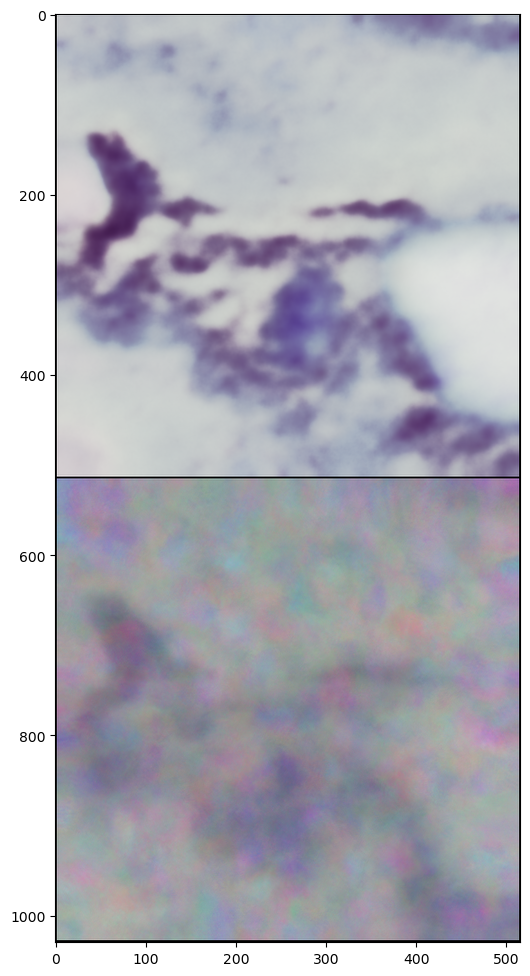

Iteration 00061    Loss 0.020713   PSNR_noisy: 16.837607   PSRN_gt: 19.331298 PSNR_gt_sm: 14.768166 
Elapsed time: 1589.8886 seconds
Iteration 00062    Loss 0.020482   PSNR_noisy: 16.886228   PSRN_gt: 19.414522 PSNR_gt_sm: 14.826916 
Elapsed time: 1615.2580 seconds
Iteration 00063    Loss 0.020033   PSNR_noisy: 16.982565   PSRN_gt: 19.587570 PSNR_gt_sm: 14.885438 
Elapsed time: 1639.7249 seconds
Iteration 00064    Loss 0.019884   PSNR_noisy: 17.015065   PSRN_gt: 19.648428 PSNR_gt_sm: 14.944349 
Elapsed time: 1664.9912 seconds
Iteration 00065    Loss 0.019918   PSNR_noisy: 17.007490   PSRN_gt: 19.635150 PSNR_gt_sm: 15.003392 
Elapsed time: 1690.2074 seconds


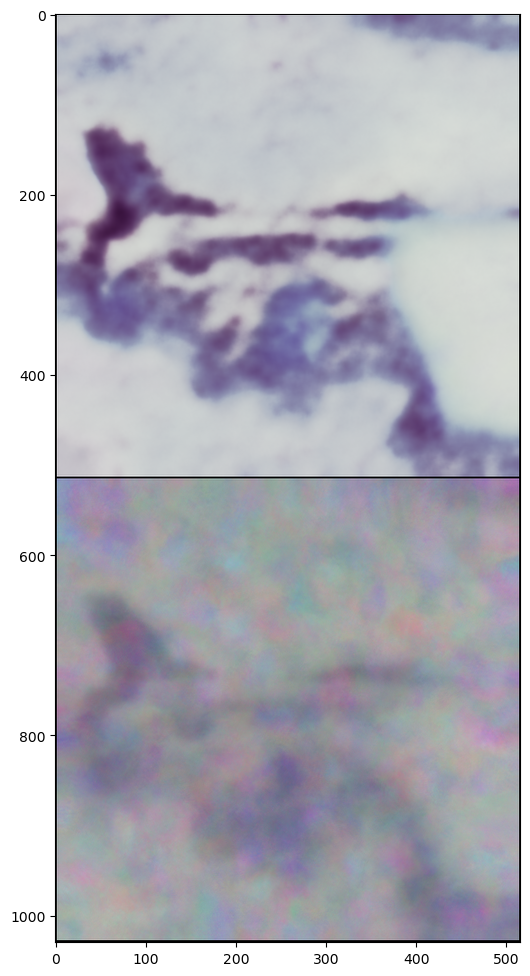

Iteration 00066    Loss 0.019967   PSNR_noisy: 16.996866   PSRN_gt: 19.605857 PSNR_gt_sm: 15.061339 
Elapsed time: 1716.0926 seconds
Iteration 00067    Loss 0.019707   PSNR_noisy: 17.053759   PSRN_gt: 19.714892 PSNR_gt_sm: 15.117900 
Elapsed time: 1741.3696 seconds
Iteration 00068    Loss 0.019750   PSNR_noisy: 17.044363   PSRN_gt: 19.693629 PSNR_gt_sm: 15.173535 
Elapsed time: 1766.7900 seconds
Iteration 00069    Loss 0.019671   PSNR_noisy: 17.061722   PSRN_gt: 19.725485 PSNR_gt_sm: 15.228553 
Elapsed time: 1792.3027 seconds
Iteration 00070    Loss 0.019626   PSNR_noisy: 17.071733   PSRN_gt: 19.754369 PSNR_gt_sm: 15.284357 
Elapsed time: 1817.6485 seconds


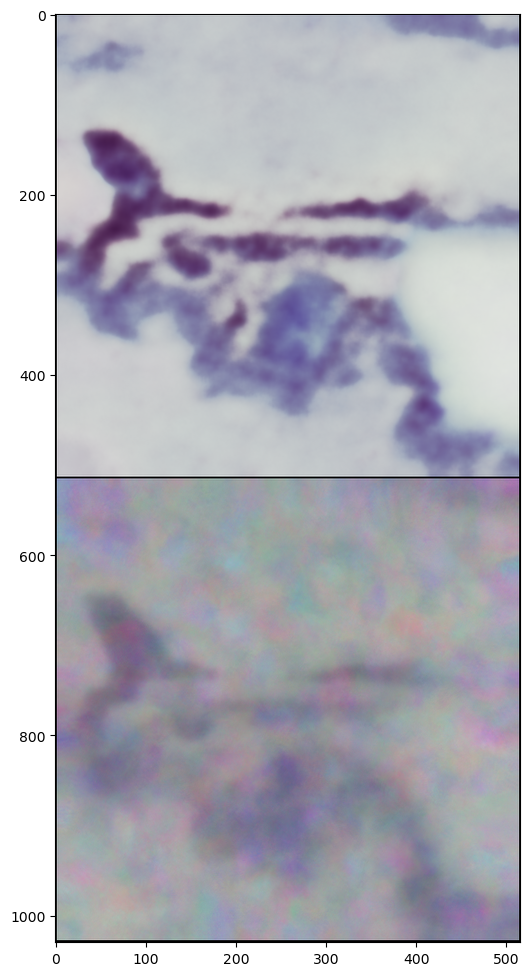

Iteration 00071    Loss 0.019444   PSNR_noisy: 17.112245   PSRN_gt: 19.832828 PSNR_gt_sm: 15.341138 
Elapsed time: 1843.5930 seconds
Iteration 00072    Loss 0.019185   PSNR_noisy: 17.170385   PSRN_gt: 19.943872 PSNR_gt_sm: 15.397771 
Elapsed time: 1869.1163 seconds
Iteration 00073    Loss 0.019088   PSNR_noisy: 17.192288   PSRN_gt: 19.984696 PSNR_gt_sm: 15.456365 
Elapsed time: 1894.5531 seconds
Iteration 00074    Loss 0.018880   PSNR_noisy: 17.239896   PSRN_gt: 20.078393 PSNR_gt_sm: 15.515169 
Elapsed time: 1919.8506 seconds
Iteration 00075    Loss 0.019090   PSNR_noisy: 17.192040   PSRN_gt: 19.980718 PSNR_gt_sm: 15.574302 
Elapsed time: 1945.1560 seconds


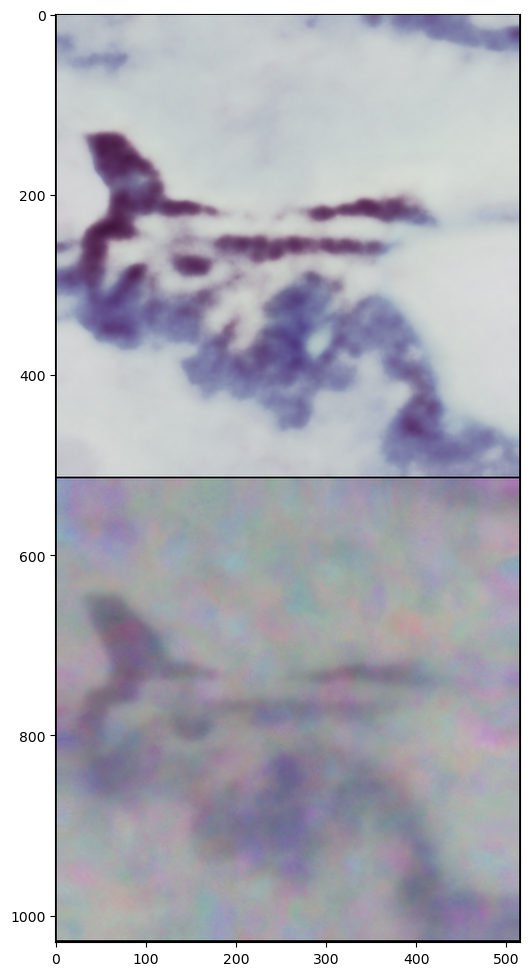

Iteration 00076    Loss 0.018838   PSNR_noisy: 17.249583   PSRN_gt: 20.090204 PSNR_gt_sm: 15.632599 
Elapsed time: 1970.8577 seconds
Iteration 00077    Loss 0.018734   PSNR_noisy: 17.273750   PSRN_gt: 20.135204 PSNR_gt_sm: 15.689975 
Elapsed time: 1995.9720 seconds
Iteration 00078    Loss 0.018901   PSNR_noisy: 17.235200   PSRN_gt: 20.064425 PSNR_gt_sm: 15.745073 
Elapsed time: 2021.4985 seconds
Iteration 00079    Loss 0.018838   PSNR_noisy: 17.249540   PSRN_gt: 20.086387 PSNR_gt_sm: 15.798085 
Elapsed time: 2046.7891 seconds
Iteration 00080    Loss 0.018615   PSNR_noisy: 17.301311   PSRN_gt: 20.190852 PSNR_gt_sm: 15.852477 
Elapsed time: 2072.0600 seconds


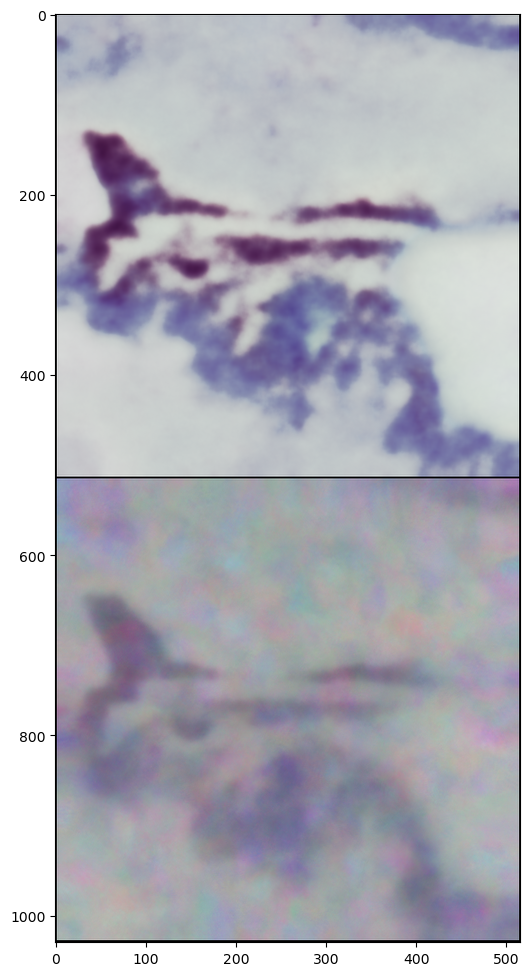

Iteration 00086    Loss 0.018015   PSNR_noisy: 17.443626   PSRN_gt: 20.467846 PSNR_gt_sm: 16.188502 
Elapsed time: 2225.3459 seconds
Iteration 00087    Loss 0.017778   PSNR_noisy: 17.501086   PSRN_gt: 20.594466 PSNR_gt_sm: 16.243811 
Elapsed time: 2250.6677 seconds
Iteration 00088    Loss 0.017967   PSNR_noisy: 17.455186   PSRN_gt: 20.500302 PSNR_gt_sm: 16.299309 
Elapsed time: 2276.1867 seconds
Iteration 00089    Loss 0.018060   PSNR_noisy: 17.432839   PSRN_gt: 20.459523 PSNR_gt_sm: 16.353687 
Elapsed time: 2301.5107 seconds
Iteration 00090    Loss 0.018116   PSNR_noisy: 17.419258   PSRN_gt: 20.425689 PSNR_gt_sm: 16.407525 
Elapsed time: 2326.7863 seconds


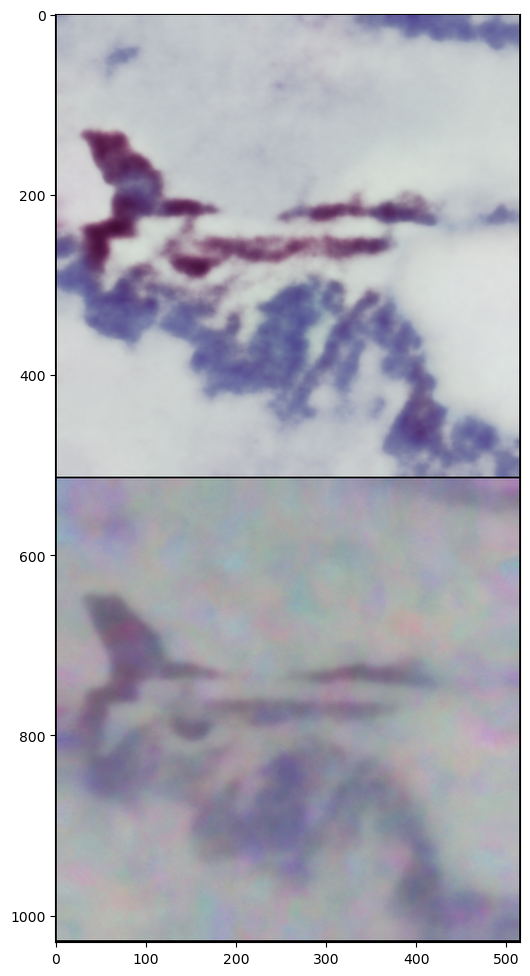

Iteration 00091    Loss 0.017695   PSNR_noisy: 17.521564   PSRN_gt: 20.637221 PSNR_gt_sm: 16.461993 
Elapsed time: 2352.8717 seconds
Iteration 00092    Loss 0.017840   PSNR_noisy: 17.486020   PSRN_gt: 20.565978 PSNR_gt_sm: 16.516422 
Elapsed time: 2378.3140 seconds
Iteration 00093    Loss 0.017603   PSNR_noisy: 17.544171   PSRN_gt: 20.683379 PSNR_gt_sm: 16.569317 
Elapsed time: 2403.6592 seconds
Iteration 00094    Loss 0.017642   PSNR_noisy: 17.534445   PSRN_gt: 20.664204 PSNR_gt_sm: 16.623295 
Elapsed time: 2428.9632 seconds
Iteration 00095    Loss 0.017608   PSNR_noisy: 17.542995   PSRN_gt: 20.677805 PSNR_gt_sm: 16.677944 
Elapsed time: 2454.4264 seconds


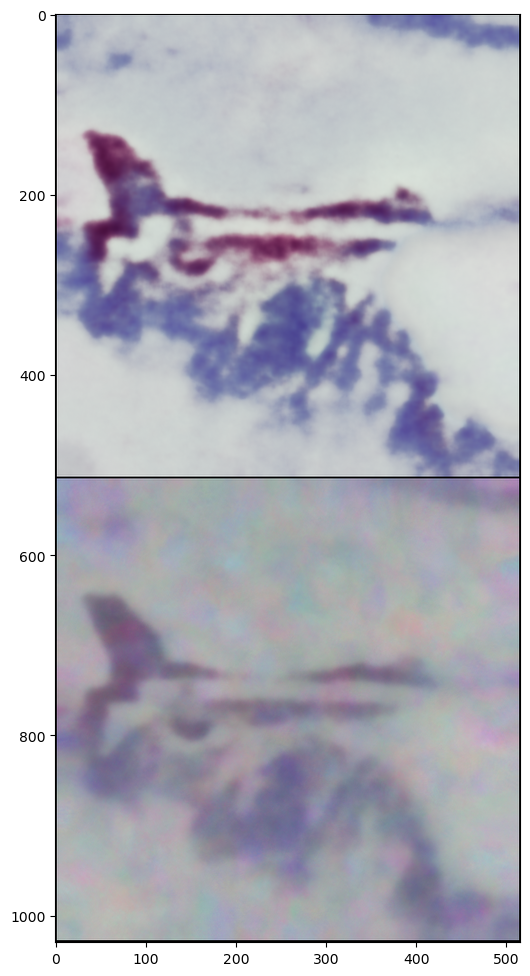

Iteration 00096    Loss 0.017794   PSNR_noisy: 17.497247   PSRN_gt: 20.583919 PSNR_gt_sm: 16.732309 
Elapsed time: 2480.5042 seconds
Iteration 00097    Loss 0.017351   PSNR_noisy: 17.606875   PSRN_gt: 20.808771 PSNR_gt_sm: 16.786889 
Elapsed time: 2505.6483 seconds
Iteration 00098    Loss 0.017346   PSNR_noisy: 17.608108   PSRN_gt: 20.814584 PSNR_gt_sm: 16.840535 
Elapsed time: 2531.0325 seconds
Iteration 00099    Loss 0.017244   PSNR_noisy: 17.633503   PSRN_gt: 20.881254 PSNR_gt_sm: 16.894157 
Elapsed time: 2556.7068 seconds
Iteration 00100    Loss 0.017335   PSNR_noisy: 17.610851   PSRN_gt: 20.832276 PSNR_gt_sm: 16.946397 
Elapsed time: 2581.8069 seconds


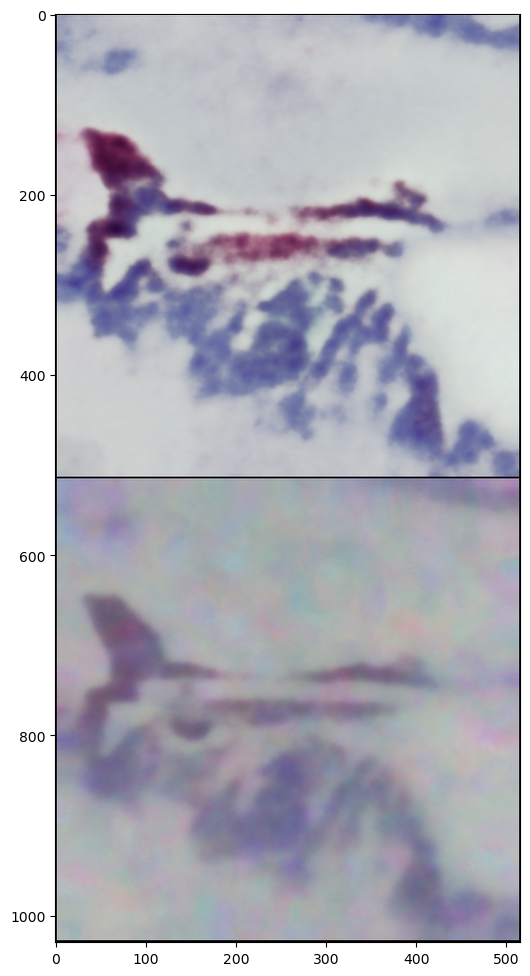

Iteration 00101    Loss 0.017218   PSNR_noisy: 17.640155   PSRN_gt: 20.886872 PSNR_gt_sm: 17.000607 
Elapsed time: 2607.8275 seconds
Iteration 00102    Loss 0.017237   PSNR_noisy: 17.635329   PSRN_gt: 20.883894 PSNR_gt_sm: 17.054415 
Elapsed time: 2632.1511 seconds
Iteration 00103    Loss 0.017082   PSNR_noisy: 17.674710   PSRN_gt: 20.970605 PSNR_gt_sm: 17.107695 
Elapsed time: 2657.2900 seconds
Iteration 00104    Loss 0.016957   PSNR_noisy: 17.706423   PSRN_gt: 21.032166 PSNR_gt_sm: 17.158771 
Elapsed time: 2682.6239 seconds
Iteration 00105    Loss 0.016907   PSNR_noisy: 17.719366   PSRN_gt: 21.055064 PSNR_gt_sm: 17.209971 
Elapsed time: 2707.8727 seconds


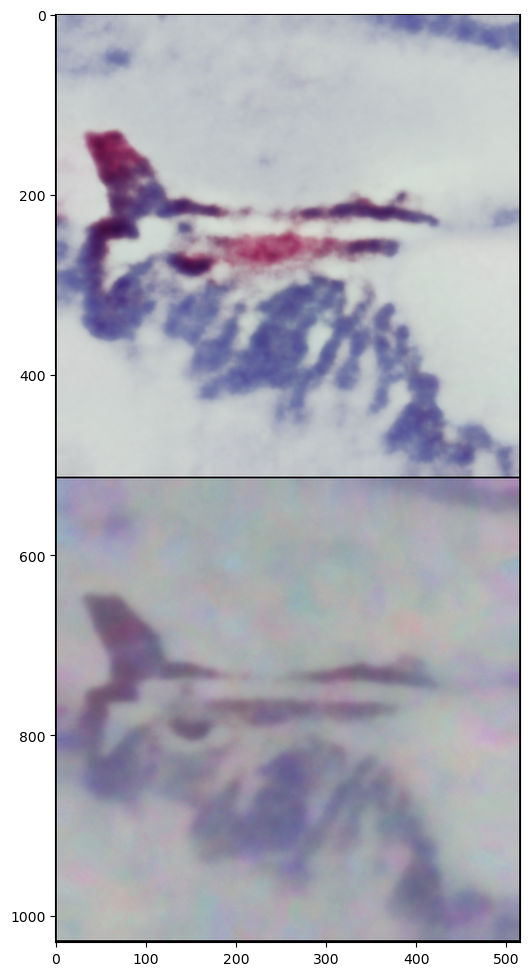

Iteration 00106    Loss 0.016846   PSNR_noisy: 17.734978   PSRN_gt: 21.088286 PSNR_gt_sm: 17.261315 
Elapsed time: 2733.9794 seconds
Iteration 00107    Loss 0.016804   PSNR_noisy: 17.745989   PSRN_gt: 21.116635 PSNR_gt_sm: 17.311864 
Elapsed time: 2759.4121 seconds
Iteration 00108    Loss 0.016866   PSNR_noisy: 17.729942   PSRN_gt: 21.082974 PSNR_gt_sm: 17.363725 
Elapsed time: 2784.7462 seconds
Iteration 00109    Loss 0.016760   PSNR_noisy: 17.757221   PSRN_gt: 21.150422 PSNR_gt_sm: 17.417189 
Elapsed time: 2810.0629 seconds
Iteration 00110    Loss 0.016579   PSNR_noisy: 17.804305   PSRN_gt: 21.247893 PSNR_gt_sm: 17.471265 
Elapsed time: 2835.3288 seconds


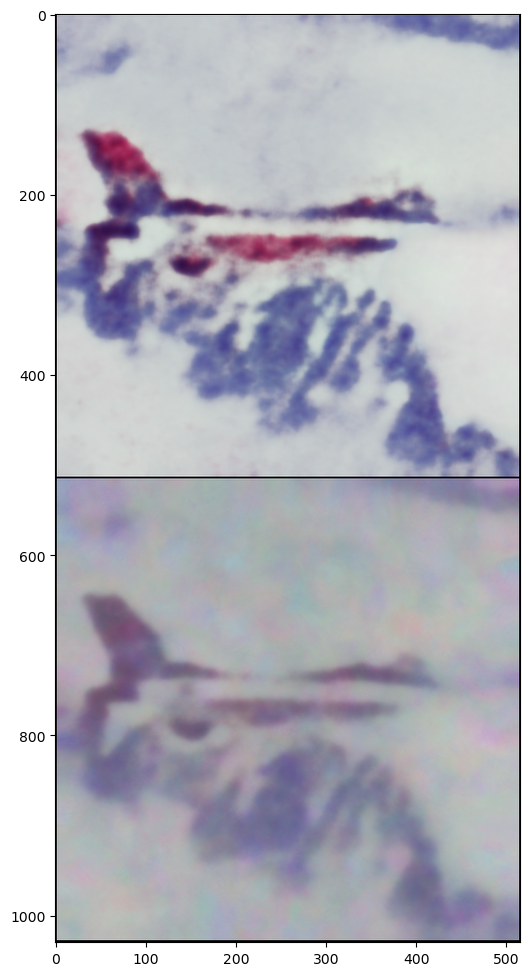

Iteration 00111    Loss 0.016638   PSNR_noisy: 17.789104   PSRN_gt: 21.224876 PSNR_gt_sm: 17.524099 
Elapsed time: 2861.2135 seconds
Iteration 00112    Loss 0.016517   PSNR_noisy: 17.820755   PSRN_gt: 21.286856 PSNR_gt_sm: 17.576322 
Elapsed time: 2886.4585 seconds
Iteration 00113    Loss 0.016472   PSNR_noisy: 17.832449   PSRN_gt: 21.298656 PSNR_gt_sm: 17.628514 
Elapsed time: 2911.7017 seconds
Iteration 00114    Loss 0.016555   PSNR_noisy: 17.810796   PSRN_gt: 21.253041 PSNR_gt_sm: 17.678987 
Elapsed time: 2936.7293 seconds
Iteration 00115    Loss 0.016491   PSNR_noisy: 17.827519   PSRN_gt: 21.286068 PSNR_gt_sm: 17.728444 
Elapsed time: 2962.2376 seconds


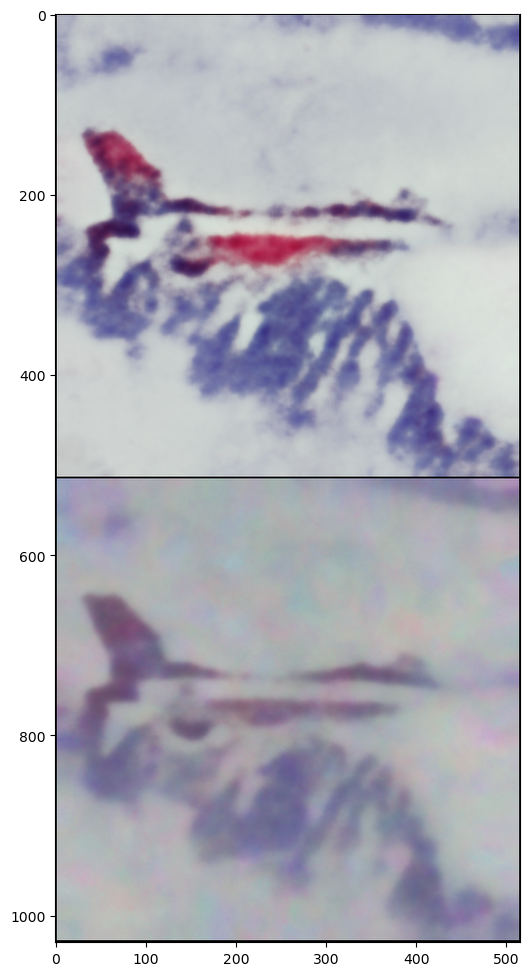

Iteration 00116    Loss 0.016473   PSNR_noisy: 17.832324   PSRN_gt: 21.300355 PSNR_gt_sm: 17.777824 
Elapsed time: 2988.1619 seconds
Iteration 00117    Loss 0.016467   PSNR_noisy: 17.833797   PSRN_gt: 21.302191 PSNR_gt_sm: 17.827295 
Elapsed time: 3013.5602 seconds
Iteration 00118    Loss 0.016421   PSNR_noisy: 17.845913   PSRN_gt: 21.342303 PSNR_gt_sm: 17.877021 
Elapsed time: 3038.8883 seconds
Iteration 00119    Loss 0.016133   PSNR_noisy: 17.922866   PSRN_gt: 21.514810 PSNR_gt_sm: 17.927854 
Elapsed time: 3064.2925 seconds
Iteration 00120    Loss 0.016230   PSNR_noisy: 17.896893   PSRN_gt: 21.456134 PSNR_gt_sm: 17.980603 
Elapsed time: 3089.5630 seconds


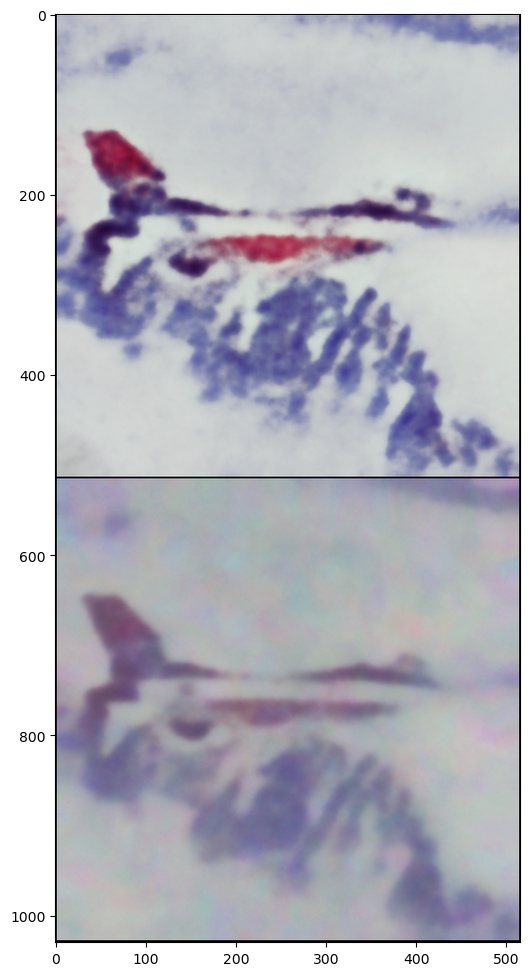

Iteration 00121    Loss 0.016340   PSNR_noisy: 17.867527   PSRN_gt: 21.390427 PSNR_gt_sm: 18.031096 
Elapsed time: 3115.3761 seconds
Iteration 00122    Loss 0.016080   PSNR_noisy: 17.937269   PSRN_gt: 21.548012 PSNR_gt_sm: 18.081084 
Elapsed time: 3140.6489 seconds
Iteration 00123    Loss 0.016020   PSNR_noisy: 17.953483   PSRN_gt: 21.580260 PSNR_gt_sm: 18.131728 
Elapsed time: 3165.9997 seconds
Iteration 00124    Loss 0.016104   PSNR_noisy: 17.930700   PSRN_gt: 21.536587 PSNR_gt_sm: 18.181437 
Elapsed time: 3191.1540 seconds
Iteration 00125    Loss 0.016298   PSNR_noisy: 17.878602   PSRN_gt: 21.410554 PSNR_gt_sm: 18.229272 
Elapsed time: 3216.6036 seconds


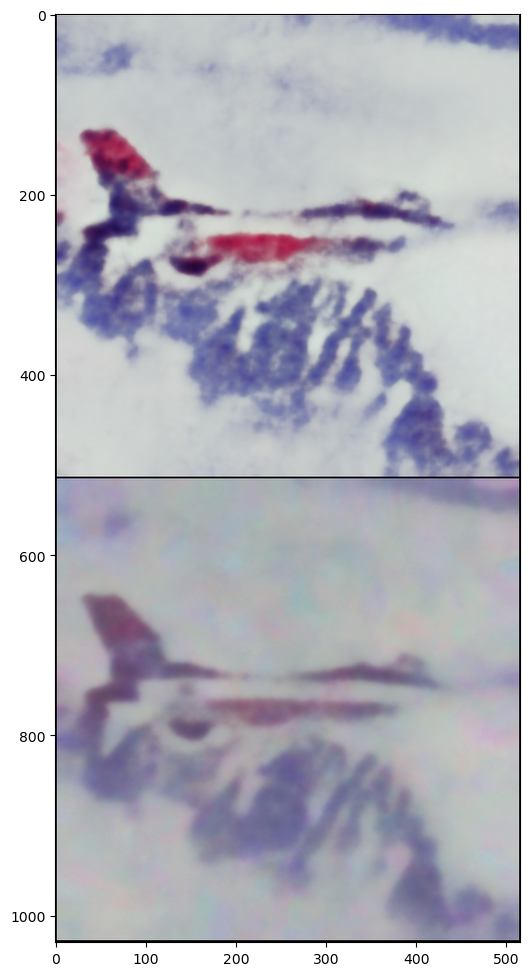

Iteration 00126    Loss 0.016134   PSNR_noisy: 17.922633   PSRN_gt: 21.506642 PSNR_gt_sm: 18.277195 
Elapsed time: 3242.5322 seconds
Iteration 00127    Loss 0.016242   PSNR_noisy: 17.893516   PSRN_gt: 21.444973 PSNR_gt_sm: 18.324023 
Elapsed time: 3267.8144 seconds
Iteration 00128    Loss 0.016058   PSNR_noisy: 17.943054   PSRN_gt: 21.562945 PSNR_gt_sm: 18.372360 
Elapsed time: 3293.0236 seconds
Iteration 00129    Loss 0.015845   PSNR_noisy: 18.001032   PSRN_gt: 21.691432 PSNR_gt_sm: 18.421615 
Elapsed time: 3318.4590 seconds
Iteration 00130    Loss 0.015982   PSNR_noisy: 17.963614   PSRN_gt: 21.616928 PSNR_gt_sm: 18.470859 
Elapsed time: 3343.7108 seconds


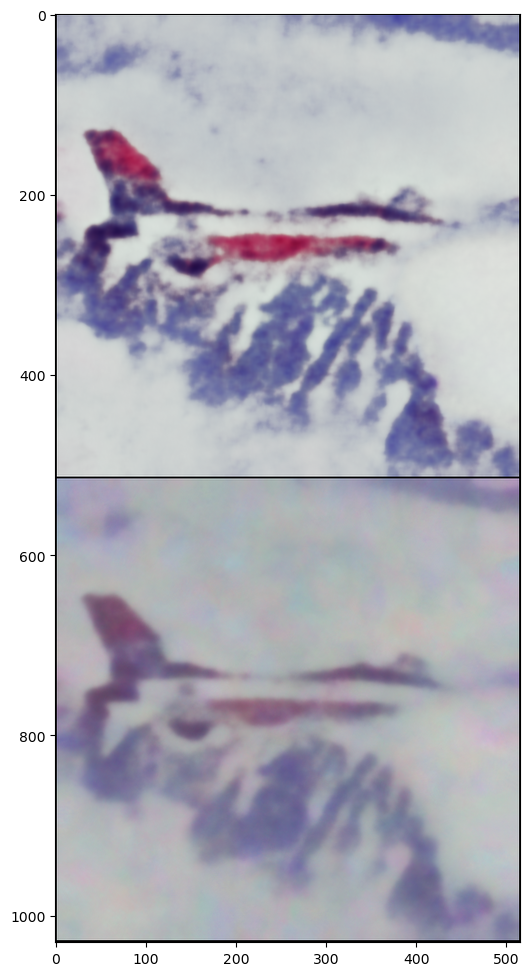

Iteration 00131    Loss 0.015924   PSNR_noisy: 17.979480   PSRN_gt: 21.648503 PSNR_gt_sm: 18.518540 
Elapsed time: 3369.7004 seconds
Iteration 00132    Loss 0.015807   PSNR_noisy: 18.011500   PSRN_gt: 21.722195 PSNR_gt_sm: 18.565646 
Elapsed time: 3394.9129 seconds
Iteration 00133    Loss 0.015888   PSNR_noisy: 17.989376   PSRN_gt: 21.663836 PSNR_gt_sm: 18.610615 
Elapsed time: 3420.2444 seconds
Iteration 00134    Loss 0.015869   PSNR_noisy: 17.994595   PSRN_gt: 21.666100 PSNR_gt_sm: 18.656912 
Elapsed time: 3445.7432 seconds
Iteration 00135    Loss 0.015735   PSNR_noisy: 18.031467   PSRN_gt: 21.763677 PSNR_gt_sm: 18.704202 
Elapsed time: 3471.2471 seconds


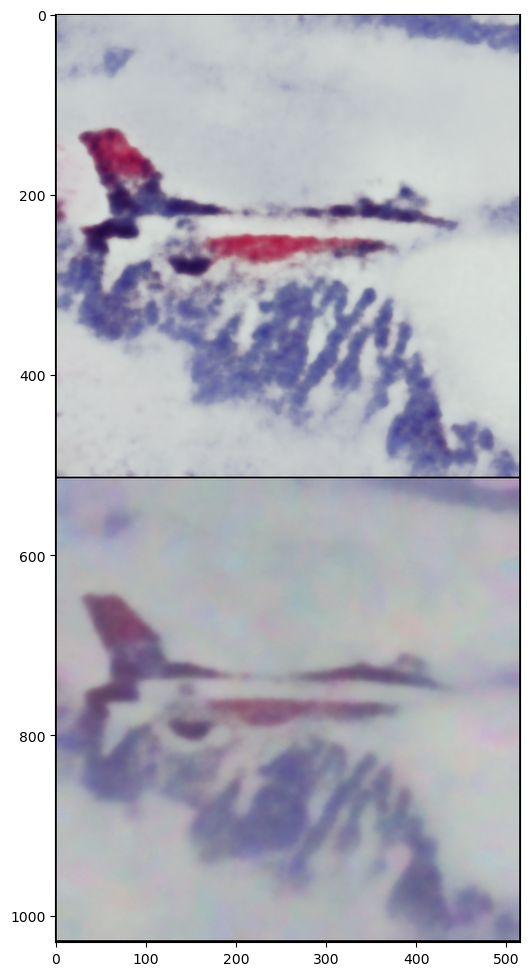

Iteration 00136    Loss 0.015794   PSNR_noisy: 18.014979   PSRN_gt: 21.735288 PSNR_gt_sm: 18.751709 
Elapsed time: 3497.2995 seconds
Iteration 00137    Loss 0.015535   PSNR_noisy: 18.086785   PSRN_gt: 21.904380 PSNR_gt_sm: 18.798507 
Elapsed time: 3522.6906 seconds
Iteration 00138    Loss 0.015660   PSNR_noisy: 18.052096   PSRN_gt: 21.822864 PSNR_gt_sm: 18.845570 
Elapsed time: 3548.1850 seconds
Iteration 00139    Loss 0.015618   PSNR_noisy: 18.063673   PSRN_gt: 21.849036 PSNR_gt_sm: 18.891501 
Elapsed time: 3573.6497 seconds
Iteration 00140    Loss 0.015693   PSNR_noisy: 18.043009   PSRN_gt: 21.792412 PSNR_gt_sm: 18.936389 
Elapsed time: 3598.9948 seconds


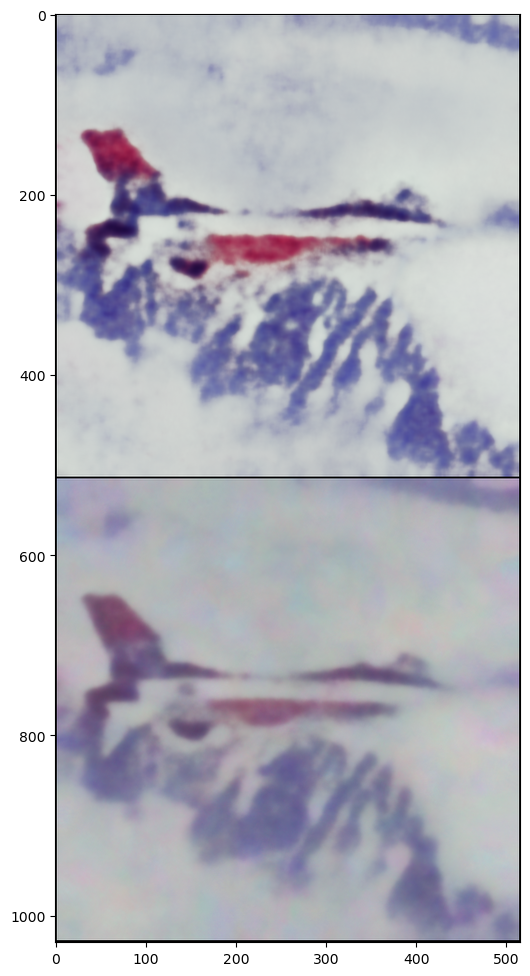

Iteration 00141    Loss 0.015688   PSNR_noisy: 18.044240   PSRN_gt: 21.802155 PSNR_gt_sm: 18.982480 
Elapsed time: 3624.9494 seconds
Iteration 00142    Loss 0.015525   PSNR_noisy: 18.089731   PSRN_gt: 21.916413 PSNR_gt_sm: 19.027923 
Elapsed time: 3650.2687 seconds
Iteration 00143    Loss 0.015551   PSNR_noisy: 18.082404   PSRN_gt: 21.887751 PSNR_gt_sm: 19.073684 
Elapsed time: 3675.6809 seconds
Iteration 00144    Loss 0.015481   PSNR_noisy: 18.101903   PSRN_gt: 21.935097 PSNR_gt_sm: 19.120288 
Elapsed time: 3700.8680 seconds
Iteration 00145    Loss 0.015434   PSNR_noisy: 18.115343   PSRN_gt: 21.961308 PSNR_gt_sm: 19.164479 
Elapsed time: 3726.3844 seconds


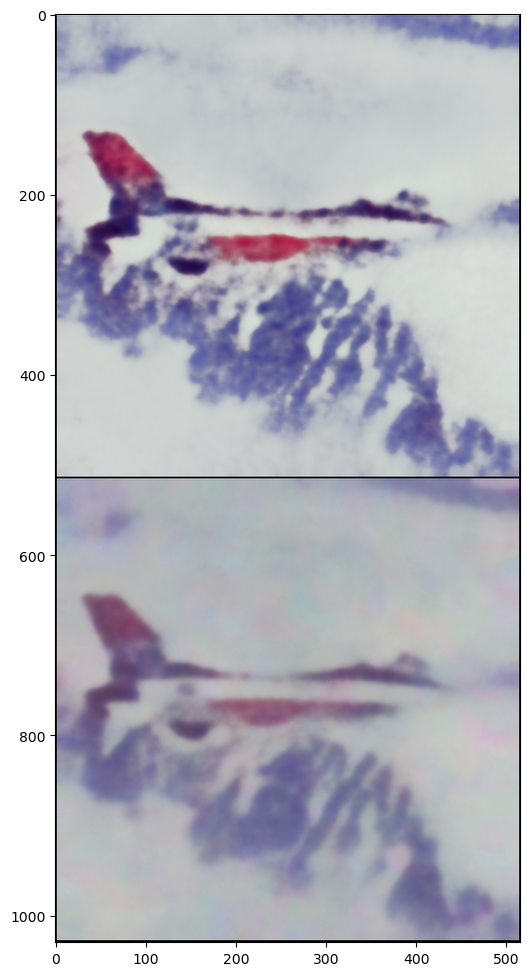

Iteration 00146    Loss 0.015552   PSNR_noisy: 18.082218   PSRN_gt: 21.887243 PSNR_gt_sm: 19.207444 
Elapsed time: 3752.5087 seconds
Iteration 00147    Loss 0.015515   PSNR_noisy: 18.092491   PSRN_gt: 21.909301 PSNR_gt_sm: 19.248295 
Elapsed time: 3777.6970 seconds
Iteration 00148    Loss 0.015397   PSNR_noisy: 18.125709   PSRN_gt: 21.985317 PSNR_gt_sm: 19.291324 
Elapsed time: 3803.2029 seconds
Iteration 00149    Loss 0.015237   PSNR_noisy: 18.170994   PSRN_gt: 22.099771 PSNR_gt_sm: 19.335998 
Elapsed time: 3828.6375 seconds
Iteration 00150    Loss 0.015488   PSNR_noisy: 18.100165   PSRN_gt: 21.925898 PSNR_gt_sm: 19.380915 
Elapsed time: 3853.8542 seconds


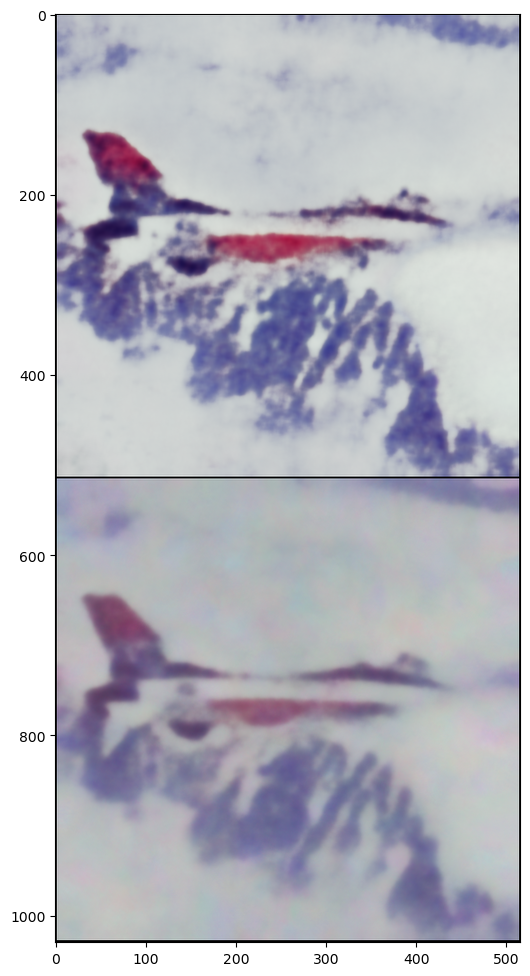

Iteration 00151    Loss 0.015446   PSNR_noisy: 18.111820   PSRN_gt: 21.949645 PSNR_gt_sm: 19.424659 
Elapsed time: 3879.9282 seconds
Iteration 00152    Loss 0.015414   PSNR_noisy: 18.120740   PSRN_gt: 21.976474 PSNR_gt_sm: 19.467081 
Elapsed time: 3905.0412 seconds
Iteration 00153    Loss 0.015396   PSNR_noisy: 18.125845   PSRN_gt: 21.985319 PSNR_gt_sm: 19.507811 
Elapsed time: 3930.2856 seconds
Iteration 00154    Loss 0.015264   PSNR_noisy: 18.163178   PSRN_gt: 22.081186 PSNR_gt_sm: 19.549039 
Elapsed time: 3955.8388 seconds
Iteration 00155    Loss 0.014997   PSNR_noisy: 18.239974   PSRN_gt: 22.269936 PSNR_gt_sm: 19.592739 
Elapsed time: 3980.9353 seconds


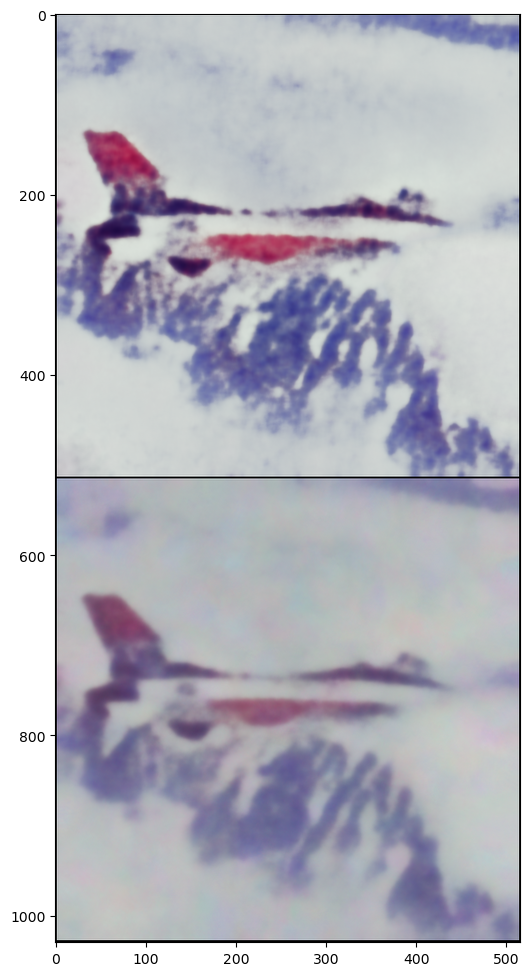

Iteration 00156    Loss 0.015005   PSNR_noisy: 18.237668   PSRN_gt: 22.265287 PSNR_gt_sm: 19.636412 
Elapsed time: 4006.7270 seconds
Iteration 00157    Loss 0.015095   PSNR_noisy: 18.211808   PSRN_gt: 22.208933 PSNR_gt_sm: 19.680033 
Elapsed time: 4032.1771 seconds
Iteration 00158    Loss 0.015039   PSNR_noisy: 18.227922   PSRN_gt: 22.247790 PSNR_gt_sm: 19.722062 
Elapsed time: 4057.7263 seconds
Iteration 00159    Loss 0.015070   PSNR_noisy: 18.218769   PSRN_gt: 22.217759 PSNR_gt_sm: 19.763207 
Elapsed time: 4083.1348 seconds
Iteration 00160    Loss 0.015183   PSNR_noisy: 18.186416   PSRN_gt: 22.133137 PSNR_gt_sm: 19.806076 
Elapsed time: 4108.4443 seconds


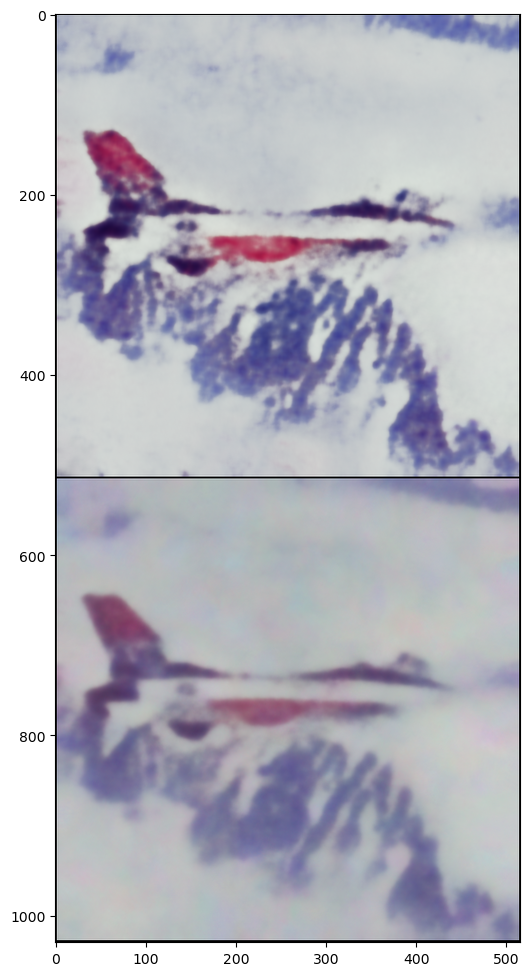

Iteration 00161    Loss 0.014938   PSNR_noisy: 18.257087   PSRN_gt: 22.318353 PSNR_gt_sm: 19.848039 
Elapsed time: 4133.9681 seconds
Iteration 00162    Loss 0.014925   PSNR_noisy: 18.260734   PSRN_gt: 22.324216 PSNR_gt_sm: 19.889432 
Elapsed time: 4159.6288 seconds
Iteration 00163    Loss 0.015043   PSNR_noisy: 18.226550   PSRN_gt: 22.235295 PSNR_gt_sm: 19.930658 
Elapsed time: 4184.4802 seconds
Iteration 00164    Loss 0.014969   PSNR_noisy: 18.247950   PSRN_gt: 22.293599 PSNR_gt_sm: 19.970238 
Elapsed time: 4209.7894 seconds
Iteration 00165    Loss 0.014944   PSNR_noisy: 18.255209   PSRN_gt: 22.317498 PSNR_gt_sm: 20.010217 
Elapsed time: 4235.3045 seconds


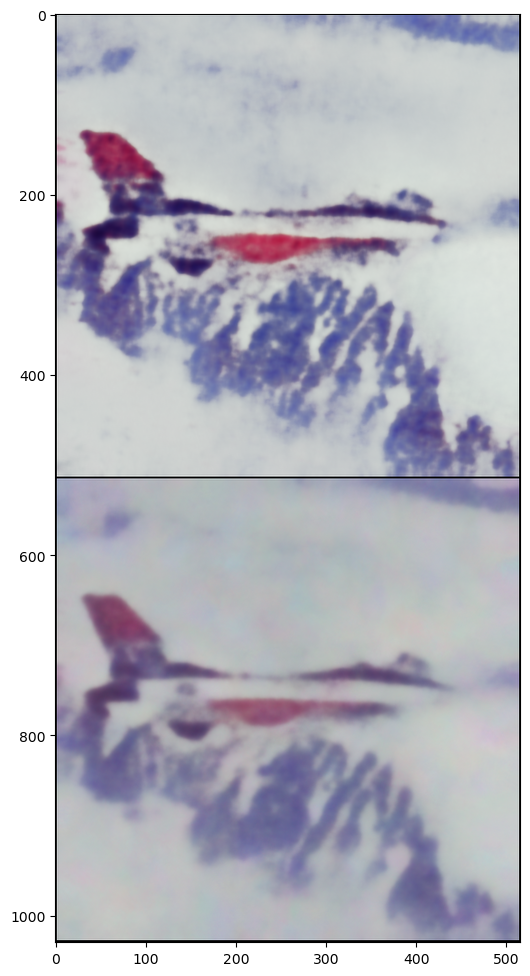

Iteration 00166    Loss 0.015028   PSNR_noisy: 18.231060   PSRN_gt: 22.253492 PSNR_gt_sm: 20.049395 
Elapsed time: 4261.1763 seconds
Iteration 00167    Loss 0.014812   PSNR_noisy: 18.293908   PSRN_gt: 22.415443 PSNR_gt_sm: 20.090308 
Elapsed time: 4286.4036 seconds
Iteration 00168    Loss 0.014813   PSNR_noisy: 18.293643   PSRN_gt: 22.420867 PSNR_gt_sm: 20.131066 
Elapsed time: 4311.8715 seconds
Iteration 00169    Loss 0.014856   PSNR_noisy: 18.281091   PSRN_gt: 22.394354 PSNR_gt_sm: 20.172083 
Elapsed time: 4336.8101 seconds
Iteration 00170    Loss 0.014814   PSNR_noisy: 18.293234   PSRN_gt: 22.424540 PSNR_gt_sm: 20.212232 
Elapsed time: 4362.0147 seconds


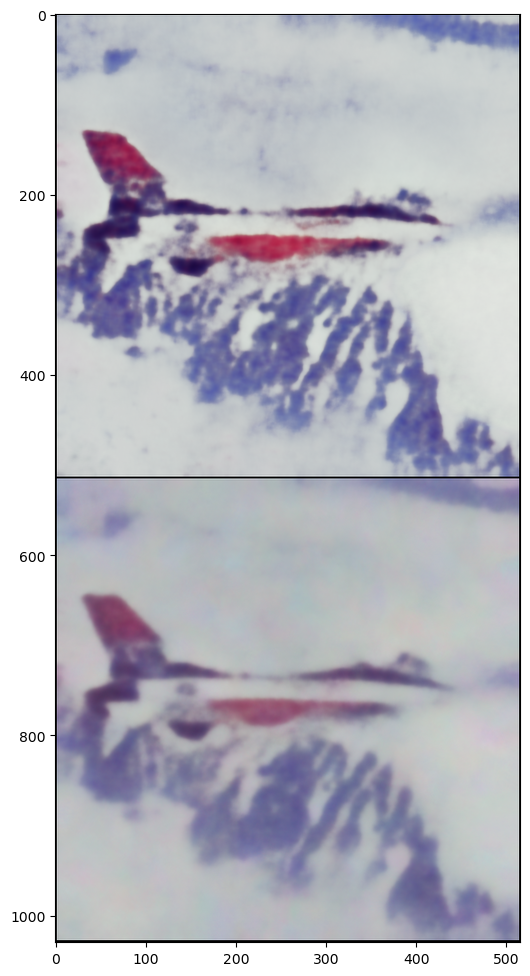

Iteration 00171    Loss 0.014683   PSNR_noisy: 18.331885   PSRN_gt: 22.522225 PSNR_gt_sm: 20.252274 
Elapsed time: 4387.9181 seconds
Iteration 00172    Loss 0.014730   PSNR_noisy: 18.318108   PSRN_gt: 22.486749 PSNR_gt_sm: 20.292597 
Elapsed time: 4413.4146 seconds
Iteration 00173    Loss 0.014766   PSNR_noisy: 18.307417   PSRN_gt: 22.441821 PSNR_gt_sm: 20.332621 
Elapsed time: 4438.8077 seconds
Iteration 00174    Loss 0.014777   PSNR_noisy: 18.304268   PSRN_gt: 22.428598 PSNR_gt_sm: 20.371095 
Elapsed time: 4464.0622 seconds
Iteration 00175    Loss 0.014628   PSNR_noisy: 18.348042   PSRN_gt: 22.551448 PSNR_gt_sm: 20.409275 
Elapsed time: 4489.3531 seconds


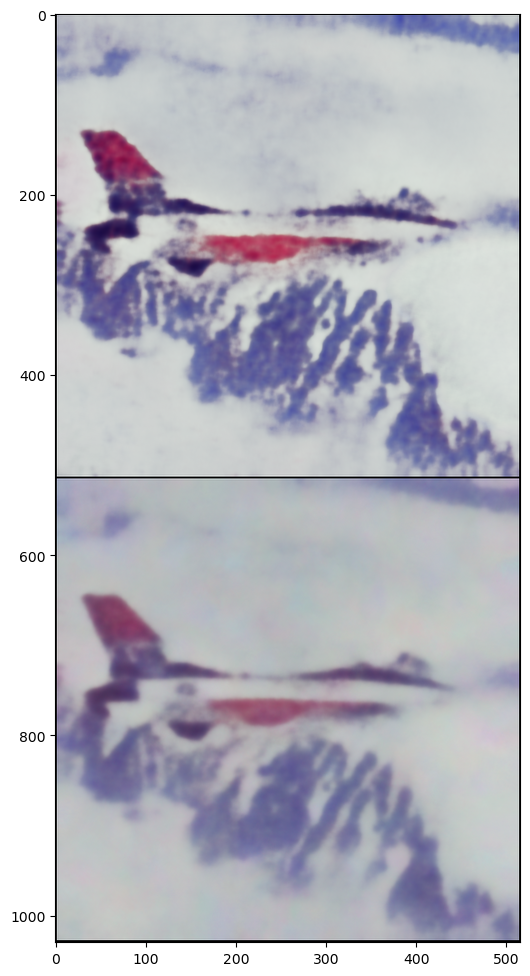

Iteration 00176    Loss 0.014869   PSNR_noisy: 18.277298   PSRN_gt: 22.367690 PSNR_gt_sm: 20.445144 
Elapsed time: 4515.6325 seconds
Iteration 00177    Loss 0.014525   PSNR_noisy: 18.378870   PSRN_gt: 22.631197 PSNR_gt_sm: 20.481621 
Elapsed time: 4541.0869 seconds
Iteration 00178    Loss 0.014567   PSNR_noisy: 18.366272   PSRN_gt: 22.605557 PSNR_gt_sm: 20.518123 
Elapsed time: 4566.4452 seconds
Iteration 00179    Loss 0.014501   PSNR_noisy: 18.385900   PSRN_gt: 22.648068 PSNR_gt_sm: 20.557136 
Elapsed time: 4591.7795 seconds
Iteration 00180    Loss 0.014566   PSNR_noisy: 18.366470   PSRN_gt: 22.599445 PSNR_gt_sm: 20.595608 
Elapsed time: 4617.1477 seconds


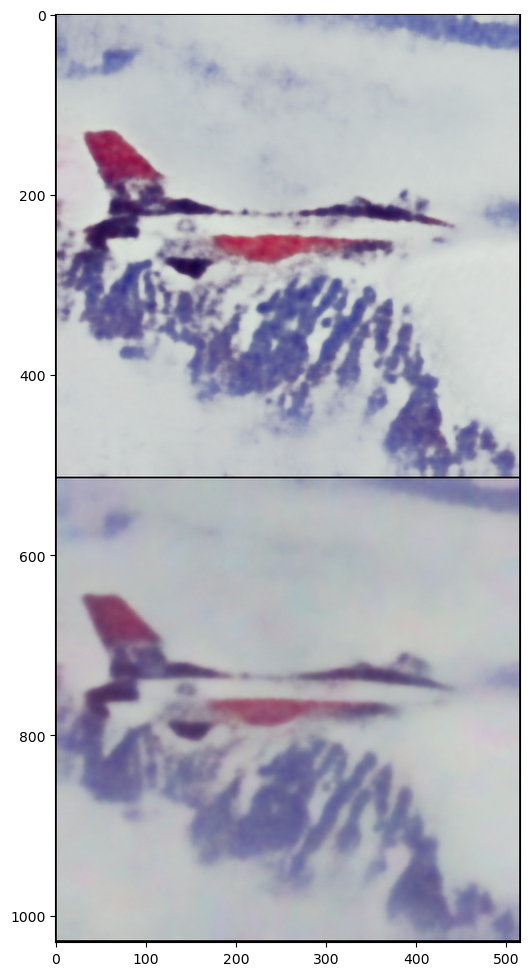

Iteration 00181    Loss 0.014812   PSNR_noisy: 18.293847   PSRN_gt: 22.404978 PSNR_gt_sm: 20.633787 
Elapsed time: 4643.2024 seconds
Iteration 00182    Loss 0.014711   PSNR_noisy: 18.323635   PSRN_gt: 22.496557 PSNR_gt_sm: 20.672768 
Elapsed time: 4668.7890 seconds
Iteration 00183    Loss 0.014466   PSNR_noisy: 18.396449   PSRN_gt: 22.691049 PSNR_gt_sm: 20.710075 
Elapsed time: 4694.0645 seconds
Iteration 00184    Loss 0.014661   PSNR_noisy: 18.338276   PSRN_gt: 22.532839 PSNR_gt_sm: 20.747333 
Elapsed time: 4719.2335 seconds
Iteration 00185    Loss 0.014509   PSNR_noisy: 18.383476   PSRN_gt: 22.653424 PSNR_gt_sm: 20.784151 
Elapsed time: 4744.7359 seconds


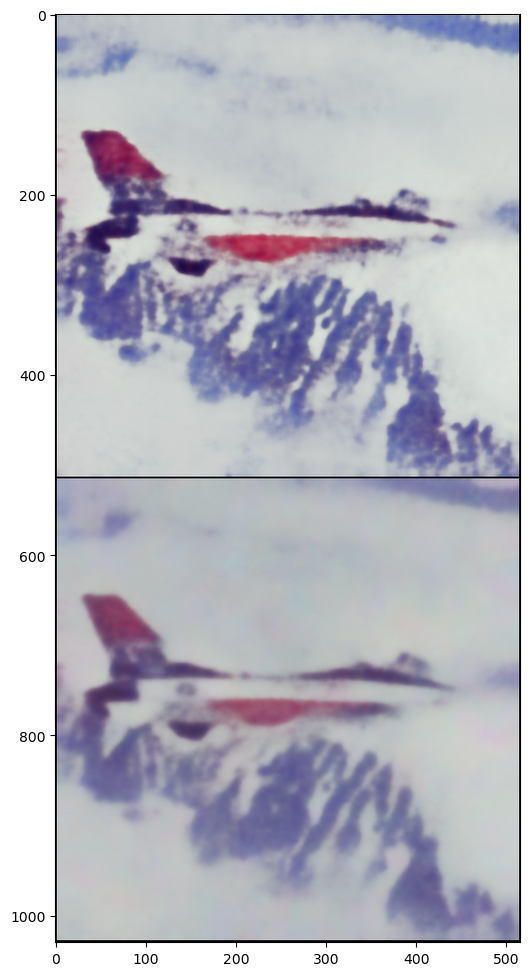

Iteration 00186    Loss 0.014423   PSNR_noisy: 18.409308   PSRN_gt: 22.724989 PSNR_gt_sm: 20.820425 
Elapsed time: 4770.7096 seconds
Iteration 00187    Loss 0.014671   PSNR_noisy: 18.335414   PSRN_gt: 22.513428 PSNR_gt_sm: 20.854579 
Elapsed time: 4795.9772 seconds
Iteration 00188    Loss 0.014416   PSNR_noisy: 18.411509   PSRN_gt: 22.716561 PSNR_gt_sm: 20.889760 
Elapsed time: 4821.3342 seconds
Iteration 00189    Loss 0.014589   PSNR_noisy: 18.359675   PSRN_gt: 22.589166 PSNR_gt_sm: 20.924791 
Elapsed time: 4846.6834 seconds
Iteration 00190    Loss 0.014374   PSNR_noisy: 18.424235   PSRN_gt: 22.746059 PSNR_gt_sm: 20.960085 
Elapsed time: 4871.8083 seconds


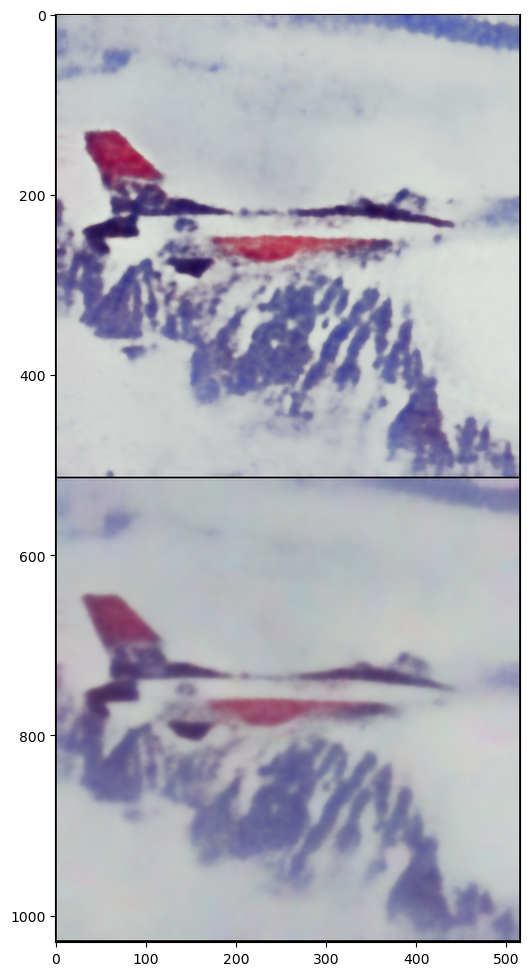

Iteration 00191    Loss 0.014209   PSNR_noisy: 18.474509   PSRN_gt: 22.886698 PSNR_gt_sm: 20.996628 
Elapsed time: 4897.6152 seconds
Iteration 00192    Loss 0.014305   PSNR_noisy: 18.445268   PSRN_gt: 22.821433 PSNR_gt_sm: 21.032863 
Elapsed time: 4922.8212 seconds
Iteration 00193    Loss 0.014230   PSNR_noisy: 18.467979   PSRN_gt: 22.874062 PSNR_gt_sm: 21.069275 
Elapsed time: 4948.1856 seconds
Iteration 00194    Loss 0.014253   PSNR_noisy: 18.460831   PSRN_gt: 22.860008 PSNR_gt_sm: 21.105336 
Elapsed time: 4973.5460 seconds
Iteration 00195    Loss 0.014163   PSNR_noisy: 18.488390   PSRN_gt: 22.935257 PSNR_gt_sm: 21.139769 
Elapsed time: 4998.9419 seconds


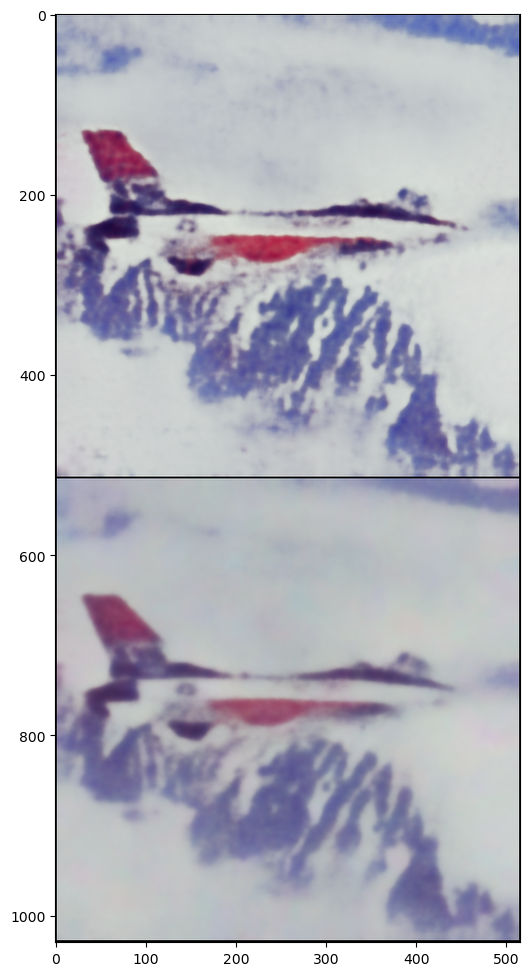

Iteration 00196    Loss 0.014121   PSNR_noisy: 18.501314   PSRN_gt: 22.972868 PSNR_gt_sm: 21.173490 
Elapsed time: 5025.0763 seconds
Iteration 00197    Loss 0.014187   PSNR_noisy: 18.481020   PSRN_gt: 22.914654 PSNR_gt_sm: 21.206772 
Elapsed time: 5050.3291 seconds
Iteration 00198    Loss 0.014177   PSNR_noisy: 18.484283   PSRN_gt: 22.929749 PSNR_gt_sm: 21.242047 
Elapsed time: 5075.7540 seconds
Iteration 00199    Loss 0.014076   PSNR_noisy: 18.515233   PSRN_gt: 23.013639 PSNR_gt_sm: 21.276921 
Elapsed time: 5100.9865 seconds
Iteration 00200    Loss 0.014074   PSNR_noisy: 18.515849   PSRN_gt: 23.017602 PSNR_gt_sm: 21.311947 
Elapsed time: 5126.4859 seconds


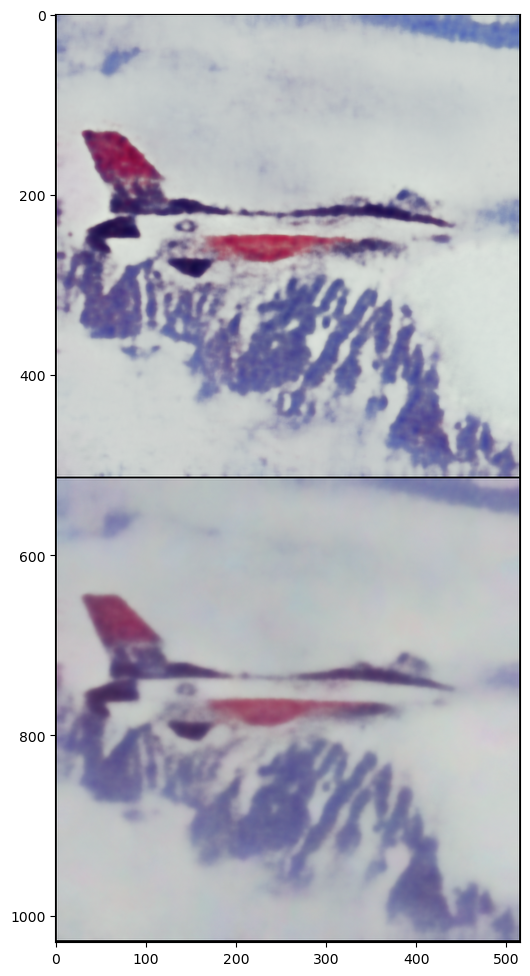

Iteration 00201    Loss 0.014100   PSNR_noisy: 18.507735   PSRN_gt: 22.989716 PSNR_gt_sm: 21.347606 
Elapsed time: 5152.2960 seconds
Iteration 00202    Loss 0.014039   PSNR_noisy: 18.526634   PSRN_gt: 23.046689 PSNR_gt_sm: 21.381599 
Elapsed time: 5177.6685 seconds
Iteration 00203    Loss 0.014154   PSNR_noisy: 18.491090   PSRN_gt: 22.941300 PSNR_gt_sm: 21.417461 
Elapsed time: 5203.1520 seconds
Iteration 00204    Loss 0.014087   PSNR_noisy: 18.511899   PSRN_gt: 23.004264 PSNR_gt_sm: 21.452109 
Elapsed time: 5228.6603 seconds
Iteration 00205    Loss 0.013910   PSNR_noisy: 18.566870   PSRN_gt: 23.171165 PSNR_gt_sm: 21.485930 
Elapsed time: 5254.1408 seconds


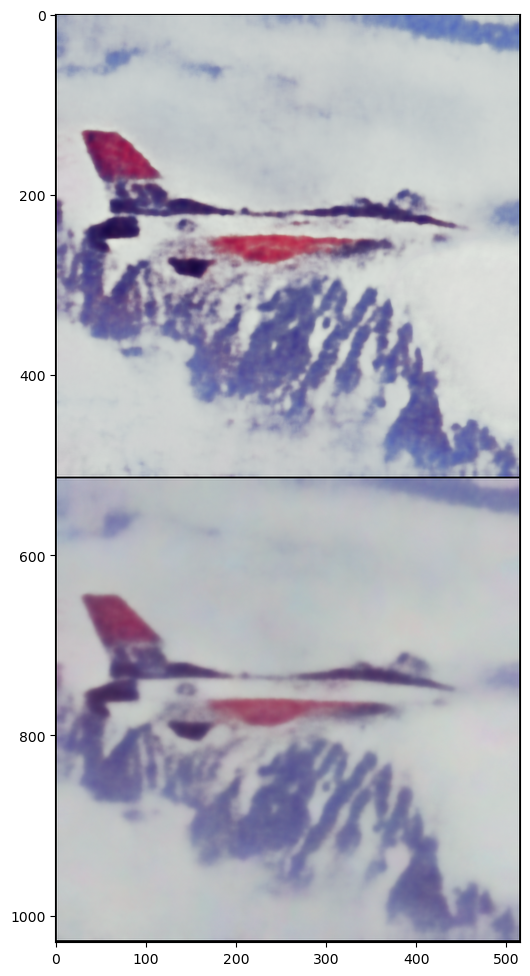

Iteration 00206    Loss 0.013980   PSNR_noisy: 18.544917   PSRN_gt: 23.098429 PSNR_gt_sm: 21.517625 
Elapsed time: 5280.2112 seconds
Iteration 00207    Loss 0.014117   PSNR_noisy: 18.502484   PSRN_gt: 22.974574 PSNR_gt_sm: 21.547306 
Elapsed time: 5305.6018 seconds
Iteration 00208    Loss 0.013997   PSNR_noisy: 18.539781   PSRN_gt: 23.062263 PSNR_gt_sm: 21.578346 
Elapsed time: 5330.9663 seconds
Iteration 00209    Loss 0.013963   PSNR_noisy: 18.550275   PSRN_gt: 23.095787 PSNR_gt_sm: 21.612340 
Elapsed time: 5356.3260 seconds
Iteration 00210    Loss 0.013969   PSNR_noisy: 18.548294   PSRN_gt: 23.088087 PSNR_gt_sm: 21.647182 
Elapsed time: 5381.6971 seconds


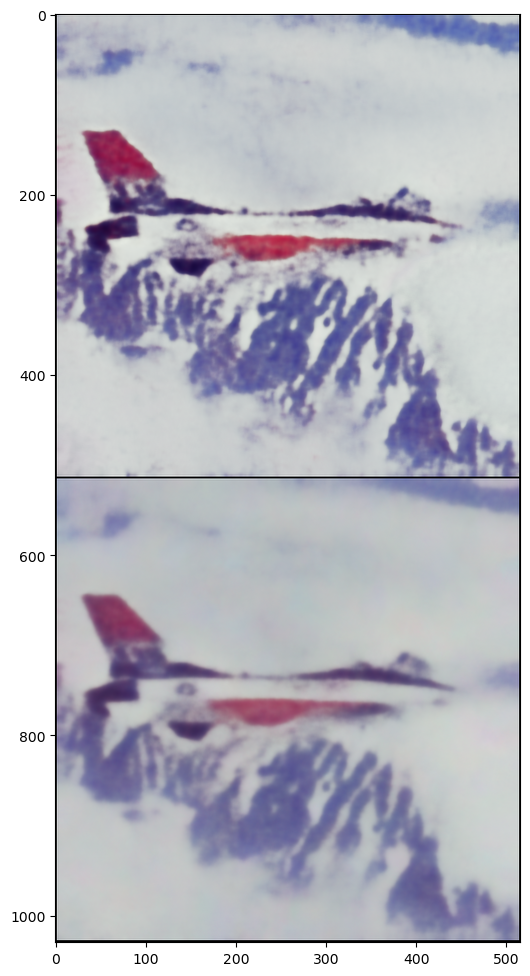

Iteration 00211    Loss 0.013991   PSNR_noisy: 18.541360   PSRN_gt: 23.074833 PSNR_gt_sm: 21.679396 
Elapsed time: 5407.7699 seconds
Iteration 00212    Loss 0.013775   PSNR_noisy: 18.609115   PSRN_gt: 23.280484 PSNR_gt_sm: 21.712550 
Elapsed time: 5433.2318 seconds
Iteration 00213    Loss 0.013895   PSNR_noisy: 18.571344   PSRN_gt: 23.158133 PSNR_gt_sm: 21.744655 
Elapsed time: 5458.7592 seconds
Iteration 00214    Loss 0.013845   PSNR_noisy: 18.586950   PSRN_gt: 23.200451 PSNR_gt_sm: 21.776142 
Elapsed time: 5484.2578 seconds
Iteration 00215    Loss 0.013847   PSNR_noisy: 18.586416   PSRN_gt: 23.204032 PSNR_gt_sm: 21.808724 
Elapsed time: 5509.3192 seconds


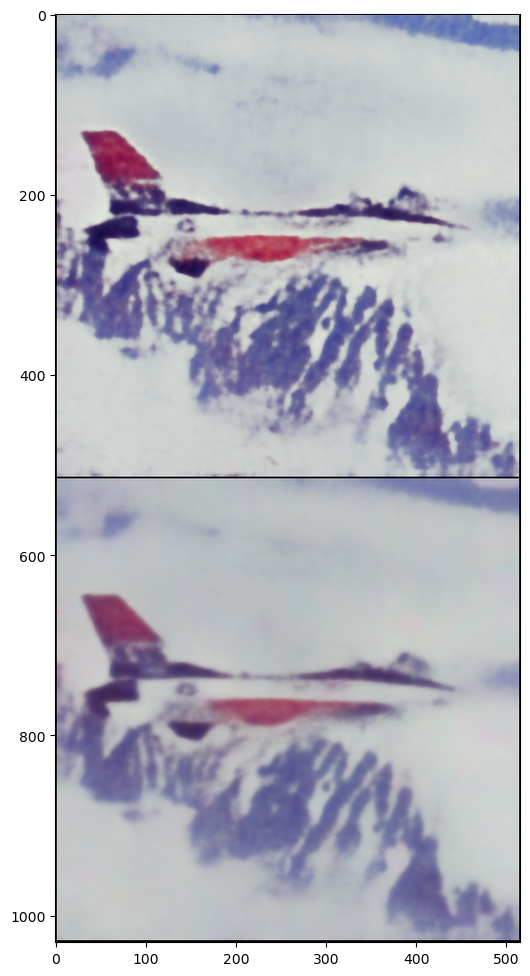

Iteration 00216    Loss 0.013905   PSNR_noisy: 18.568421   PSRN_gt: 23.144753 PSNR_gt_sm: 21.841975 
Elapsed time: 5535.2519 seconds
Iteration 00217    Loss 0.013836   PSNR_noisy: 18.589984   PSRN_gt: 23.221284 PSNR_gt_sm: 21.874866 
Elapsed time: 5560.7699 seconds
Iteration 00218    Loss 0.013859   PSNR_noisy: 18.582588   PSRN_gt: 23.202223 PSNR_gt_sm: 21.905395 
Elapsed time: 5586.3314 seconds
Iteration 00219    Loss 0.013894   PSNR_noisy: 18.571603   PSRN_gt: 23.161673 PSNR_gt_sm: 21.934177 
Elapsed time: 5611.5893 seconds
Iteration 00220    Loss 0.013721   PSNR_noisy: 18.626188   PSRN_gt: 23.328500 PSNR_gt_sm: 21.964555 
Elapsed time: 5637.0053 seconds


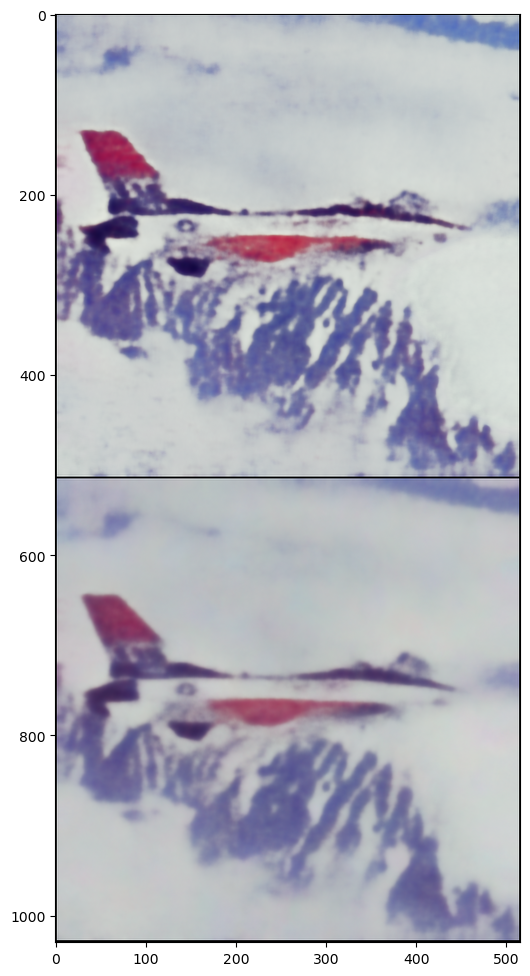

Iteration 00221    Loss 0.013801   PSNR_noisy: 18.600883   PSRN_gt: 23.251719 PSNR_gt_sm: 21.996326 
Elapsed time: 5662.9841 seconds
Iteration 00222    Loss 0.013716   PSNR_noisy: 18.627868   PSRN_gt: 23.335605 PSNR_gt_sm: 22.028171 
Elapsed time: 5688.4795 seconds
Iteration 00223    Loss 0.013713   PSNR_noisy: 18.628673   PSRN_gt: 23.327439 PSNR_gt_sm: 22.058910 
Elapsed time: 5713.7148 seconds
Iteration 00224    Loss 0.013726   PSNR_noisy: 18.624441   PSRN_gt: 23.314489 PSNR_gt_sm: 22.088658 
Elapsed time: 5739.2752 seconds
Iteration 00225    Loss 0.013717   PSNR_noisy: 18.627458   PSRN_gt: 23.321041 PSNR_gt_sm: 22.118637 
Elapsed time: 5764.4289 seconds


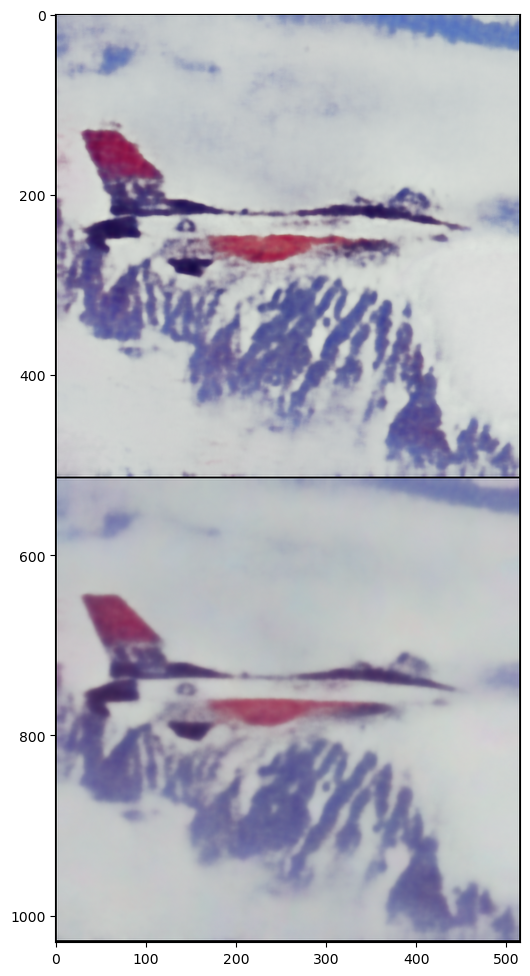

KeyboardInterrupt: 

In [6]:
net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()
out_avg = None
last_net = None
psrn_noisy_last = 0

i = 0
iterations = []
losses = []

def closure():
    
    global i, out_avg, psrn_noisy_last, last_net, net_input
    
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)
    
    out = net(net_input)
    
    # Smoothing
    if out_avg is None:
        out_avg = out.detach()
    else:
        out_avg = out_avg * exp_weight + out.detach() * (1 - exp_weight)
            
    total_loss = mse(out, img_noisy_torch)
    total_loss.backward()
        
    
    psrn_noisy = compare_psnr(img_noisy_np, out.detach().cpu().numpy()[0]) 
    psrn_gt    = compare_psnr(img_np, out.detach().cpu().numpy()[0]) 
    psrn_gt_sm = compare_psnr(img_np, out_avg.detach().cpu().numpy()[0]) 
    
    # Note that we do not have GT for the "snail" example
    # So 'PSRN_gt', 'PSNR_gt_sm' make no sense
    print ('Iteration %05d    Loss %f   PSNR_noisy: %f   PSRN_gt: %f PSNR_gt_sm: %f' % (i, total_loss.item(), psrn_noisy, psrn_gt, psrn_gt_sm), '\r', end='')
    print (f"\nElapsed time: {(time.perf_counter() - start_time):.4f} seconds")
    
    iterations.append(i)
    losses.append(total_loss.item())
    
    if  np.isnan(total_loss.item()):
        print ("nan loss")
        exit()
    
    if  PLOT and i % show_every == 0:
        out_np = torch_to_np(out)
        plot_image_grid([np.clip(out_np, 0, 1), 
                         np.clip(torch_to_np(out_avg), 0, 1)], factor=figsize, nrow=1)
        
        
    
    # Backtracking
    if i % show_every:
        if psrn_noisy - psrn_noisy_last < -5: 
            print('Falling back to previous checkpoint.')

            for new_param, net_param in zip(last_net, net.parameters()):
                net_param.data.copy_(new_param.cuda())

            return total_loss*0
        else:
            last_net = [x.detach().cpu() for x in net.parameters()]
            psrn_noisy_last = psrn_noisy
            
    i += 1

    return total_loss

p = get_params(OPT_OVER, net, net_input)
optimize(OPTIMIZER, p, closure, LR, num_iter)

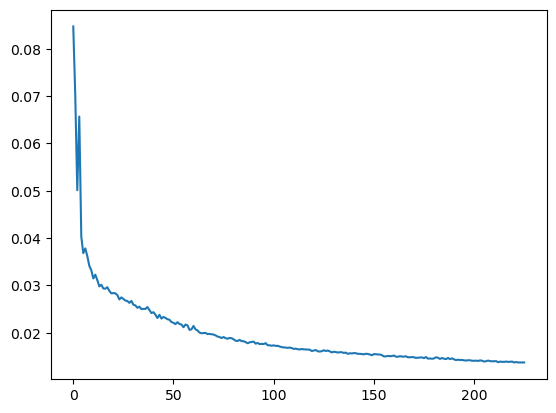

In [7]:
plt.plot(iterations, losses)
plt.show()

In [8]:
# import matplotlib.pyplot as plt

# net_input_saved = net_input.detach().clone()
# noise = net_input.detach().clone()
# out_avg = None
# last_net = None
# psrn_noisy_last = 0

# i = 0

# # iterations = []
# # losses = []
# def closure():
    
#     global i, out_avg, psrn_noisy_last, last_net, net_input
    
#     if reg_noise_std > 0:
#         net_input = net_input_saved + (noise.normal_() * reg_noise_std)
    
#     out = net(net_input)
    
#     # Smoothing
#     if out_avg is None:
#         out_avg = out.detach()
#     else:
#         out_avg = out_avg * exp_weight + out.detach() * (1 - exp_weight)
            
#     total_loss = mse(out, img_noisy_torch)
#     total_loss.backward()
        
    
#     psrn_noisy = compare_psnr(img_noisy_np, out.detach().cpu().numpy()[0]) 
#     psrn_gt    = compare_psnr(img_np, out.detach().cpu().numpy()[0]) 
#     psrn_gt_sm = compare_psnr(img_np, out_avg.detach().cpu().numpy()[0]) 
    
#     # Note that we do not have GT for the "snail" example
#     # So 'PSRN_gt', 'PSNR_gt_sm' make no sense
#     print ('Iteration %05d    Loss %f   PSNR_noisy: %f   PSRN_gt: %f PSNR_gt_sm: %f' % (i, total_loss.item(), psrn_noisy, psrn_gt, psrn_gt_sm), '\r', end='')
    
# #     iterations.append(i)
# #     losses.append(total_loss.item())
#     if  PLOT and i % show_every == 0:
#         out_np = torch_to_np(out)
#         plot_image_grid([np.clip(out_np, 0, 1), 
#                          np.clip(torch_to_np(out_avg), 0, 1)], factor=figsize, nrow=1)
        
        
    
#     # Backtracking
#     if i % show_every:
#         if psrn_noisy - psrn_noisy_last < -5: 
#             print('Falling back to previous checkpoint.')

#             for new_param, net_param in zip(last_net, net.parameters()):
#                 net_param.data.copy_(new_param.cuda())

#             return total_loss*0
#         else:
#             last_net = [x.detach().cpu() for x in net.parameters()]
#             psrn_noisy_last = psrn_noisy
            
#     i += 1

#     return total_loss

# p = get_params(OPT_OVER, net, net_input)
# optimize(OPTIMIZER, p, closure, LR, num_iter)
# # plt.plot(iterations, losses)
# # plt.show()

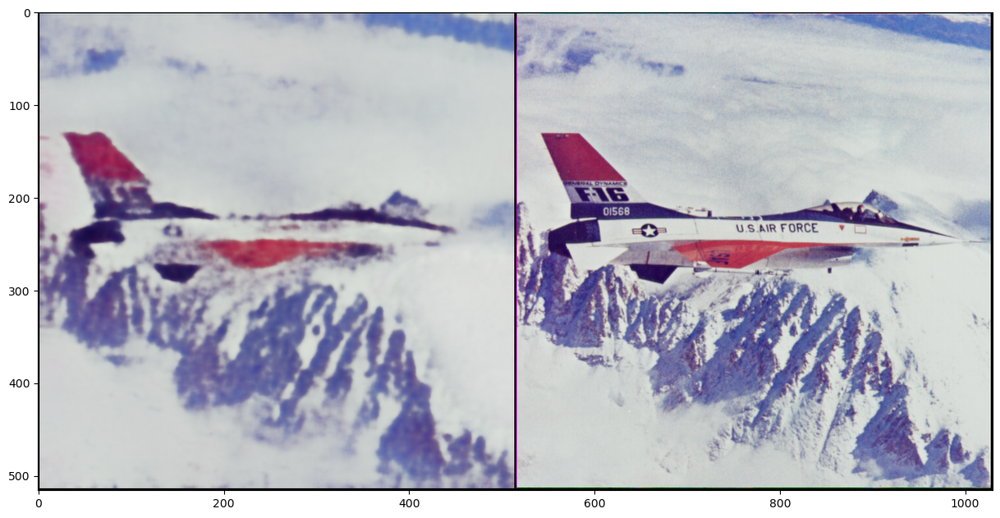

In [9]:
out_np = torch_to_np(net(net_input))
q = plot_image_grid([np.clip(out_np, 0, 1), img_np], factor=13);